# Diaptera wings classification using Topological Data Analysis

Guilherme Vituri F. Pinto [](https://orcid.org/0000-0002-7813-8777) (Universidade Estadual Paulista)  
Sergio UraNorthonDecember 5, 2025

We studied etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc etc

In [1]:
using TDAfly, TDAfly.Preprocessing, TDAfly.TDA, TDAfly.Analysis
using Images: mosaicview
using Plots: plot, display, heatmap, scatter
using PersistenceDiagrams

## 1 Introduction

Falar sobre o dataset, TDA, etc.

## 2 Methods

All images are in the `images/processed` directory. For each image, we load it, apply a gaussian blur, crop and make it have 150 pixels of height. The blurring step is necessary to “glue” small holes in the figure and keep it connected.

In [1]:
paths = readdir("images/processed", join = true)
species = basename.(paths) .|> (x -> replace(x, ".png" => ""))
individuals = map(species) do specie
  s = split(specie, " ")
  s[1][1] * "-" * s[2]
end
wings = load_wing.(paths, blur = 1.3)
Xs = map(image_to_r2, wings);


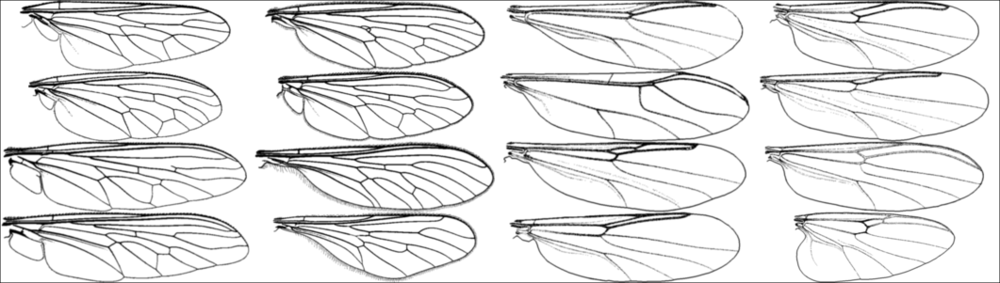

In [1]:
mosaicview(wings, ncol = 4, fillvalue=1)

### 2.1 Vietoris-Rips filtration

We select 500 points from each image using a farthest point sample method

In [1]:
samples = map(Xs) do X
  ids = farthest_points_sample(X, 500)
  X[ids]
end;

and create an empty dictionary to store all computations

In [1]:
simple_rips_dc = Dict();

We then calculate its persistence diagrams using the Vietoris-Rips filtration etc.

In [1]:
# get only the 1-dimensional PD
simple_rips_dc["PD"] = rips_pd.(samples, cutoff = 5, threshold = 200) .|> last;

We create the 1-dimensional persistence image for each persistence diagram using 10x10 matrices

In [1]:
PI = PersistenceImage(simple_rips_dc["PD"], size = (10, 10))

simple_rips_dc["PI"] = PI.(simple_rips_dc["PD"]);

#### 2.1.1 Examples

Below are some examples of 1-dimensional barcodes, its persistence image and the original wing that generated it. Note: we are plotting the barcode using the birth and persistence.

In [1]:
# plot some images to see the barcodes
map([1, 4, 8, 10, 15]) do i
  p = plot_wing_with_pd(simple_rips_dc["PD"][i], simple_rips_dc["PI"][i], samples[i], species[i])
  display(p)
end;

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip520)" d="M466.042 928.945 Q462.431 928.945 460.602 932.51 Q458.796 936.051 458.796 943.181 Q458.796 950.287 460.602 953.852 Q462.431 957.394 466.042 957.394 Q469.676 957.394 471.482 953.852 Q473.31 950.287 473.31 943.181 Q473.31 936.051 471.482 932.51 Q469.676 928.945 466.042 928.945 M466.042 925.241 Q471.852 925.241 474.907 929.848 Q477.986 934.431 477.986 943.181 Q477.986 951.908 474.907 956.514 Q471.852 961.097 466.042 961.097 Q460.232 961.097 457.153 956.514 Q454.097 951.908 454.097 943.181 Q454.097 934.431 457.153 929.848 Q460.232 925.241 466.042 925.241 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip520)" d="M600.81 928.945 Q597.199 928.945 595.37 932.51 Q593.565 936.051 593.565 943.181 Q593.565 950.287 595.37 953.852 Q597.199 957.394 600.81 957.394 Q604.444 957.394 606.25 953.852 Q608.078 950.287 608.078 943.181 Q608.078 936.051 606.25 932.51 Q604.444 928.945 600.81 928.945 M600.81 925.241 Q606.62 925.241 609.676 929.848 Q612.754 934.431 612.754 943.181 Q612.754 951.908 609.676 956.514 Q606.62 961.097 600.81 961.097 Q595 961.097 591.921 956.514 Q588.866 951.908 588.866 943.181 Q588.866 934.431 591.921 929.848 Q595 925.241 600.81 925.241 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip520)" d="M686.273 956.491 L702.592 956.491 L702.592 960.426 L680.648 960.426 L680.648 956.491 Q683.31 953.736 687.893 949.107 Q692.5 944.454 693.68 943.111 Q695.926 940.588 696.805 938.852 Q697.708 937.093 697.708 935.403 Q697.708 932.649 695.764 930.912 Q693.842 929.176 690.741 929.176 Q688.541 929.176 686.088 929.94 Q683.657 930.704 680.879 932.255 L680.879 927.533 Q683.704 926.399 686.157 925.82 Q688.611 925.241 690.648 925.241 Q696.018 925.241 699.213 927.926 Q702.407 930.612 702.407 935.102 Q702.407 937.232 701.597 939.153 Q700.81 941.051 698.703 943.644 Q698.125 944.315 695.023 947.533 Q691.921 950.727 686.273 956.491 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip520)" d="M722.407 928.945 Q718.796 928.945 716.967 932.51 Q715.162 936.051 715.162 943.181 Q715.162 950.287 716.967 953.852 Q718.796 957.394 722.407 957.394 Q726.041 957.394 727.847 953.852 Q729.675 950.287 729.675 943.181 Q729.675 936.051 727.847 932.51 Q726.041 928.945 722.407 928.945 M722.407 925.241 Q728.217 925.241 731.273 929.848 Q734.351 934.431 734.351 943.181 Q734.351 951.908 731.273 956.514 Q728.217 961.097 722.407 961.097 Q716.597 961.097 713.518 956.514 Q710.463 951.908 710.463 943.181 Q710.463 934.431 713.518 929.848 Q716.597 925.241 722.407 925.241 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip520)" d="M817.071 941.792 Q820.428 942.51 822.303 944.778 Q824.201 947.047 824.201 950.38 Q824.201 955.496 820.682 958.297 Q817.164 961.097 810.682 961.097 Q808.506 961.097 806.192 960.658 Q803.9 960.241 801.446 959.384 L801.446 954.871 Q803.391 956.005 805.706 956.584 Q808.02 957.162 810.544 957.162 Q814.942 957.162 817.233 955.426 Q819.548 953.69 819.548 950.38 Q819.548 947.324 817.395 945.611 Q815.266 943.875 811.446 943.875 L807.419 943.875 L807.419 940.033 L811.631 940.033 Q815.081 940.033 816.909 938.667 Q818.738 937.278 818.738 934.686 Q818.738 932.024 816.84 930.612 Q814.965 929.176 811.446 929.176 Q809.525 929.176 807.326 929.593 Q805.127 930.01 802.488 930.889 L802.488 926.723 Q805.15 925.982 807.465 925.612 Q809.803 925.241 811.863 925.241 Q817.187 925.241 820.289 927.672 Q823.391 930.079 823.391 934.199 Q823.391 937.07 821.747 939.061 Q820.104 941.028 817.071 941.792 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip520)" d="M843.066 928.945 Q839.455 928.945 837.627 932.51 Q835.821 936.051 835.821 943.181 Q835.821 950.287 837.627 953.852 Q839.455 957.394 843.066 957.394 Q846.701 957.394 848.506 953.852 Q850.335 950.287 850.335 943.181 Q850.335 936.0

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip580)" d="M466.042 928.945 Q462.431 928.945 460.602 932.51 Q458.796 936.051 458.796 943.181 Q458.796 950.287 460.602 953.852 Q462.431 957.394 466.042 957.394 Q469.676 957.394 471.482 953.852 Q473.31 950.287 473.31 943.181 Q473.31 936.051 471.482 932.51 Q469.676 928.945 466.042 928.945 M466.042 925.241 Q471.852 925.241 474.907 929.848 Q477.986 934.431 477.986 943.181 Q477.986 951.908 474.907 956.514 Q471.852 961.097 466.042 961.097 Q460.232 961.097 457.153 956.514 Q454.097 951.908 454.097 943.181 Q454.097 934.431 457.153 929.848 Q460.232 925.241 466.042 925.241 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip580)" d="M576.931 928.945 Q573.32 928.945 571.491 932.51 Q569.686 936.051 569.686 943.181 Q569.686 950.287 571.491 953.852 Q573.32 957.394 576.931 957.394 Q580.565 957.394 582.371 953.852 Q584.199 950.287 584.199 943.181 Q584.199 936.051 582.371 932.51 Q580.565 928.945 576.931 928.945 M576.931 925.241 Q582.741 925.241 585.797 929.848 Q588.875 934.431 588.875 943.181 Q588.875 951.908 585.797 956.514 Q582.741 961.097 576.931 961.097 Q571.121 961.097 568.042 956.514 Q564.987 951.908 564.987 943.181 Q564.987 934.431 568.042 929.848 Q571.121 925.241 576.931 925.241 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip580)" d="M638.515 956.491 L654.834 956.491 L654.834 960.426 L632.89 960.426 L632.89 956.491 Q635.552 953.736 640.135 949.107 Q644.742 944.454 645.922 943.111 Q648.167 940.588 649.047 938.852 Q649.95 937.093 649.95 935.403 Q649.95 932.649 648.005 930.912 Q646.084 929.176 642.982 929.176 Q640.783 929.176 638.33 929.94 Q635.899 930.704 633.121 932.255 L633.121 927.533 Q635.945 926.399 638.399 925.82 Q640.853 925.241 642.89 925.241 Q648.26 925.241 651.455 927.926 Q654.649 930.612 654.649 935.102 Q654.649 937.232 653.839 939.153 Q653.052 941.051 650.945 943.644 Q650.367 944.315 647.265 947.533 Q644.163 950.727 638.515 956.491 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip580)" d="M674.649 928.945 Q671.038 928.945 669.209 932.51 Q667.404 936.051 667.404 943.181 Q667.404 950.287 669.209 953.852 Q671.038 957.394 674.649 957.394 Q678.283 957.394 680.089 953.852 Q681.917 950.287 681.917 943.181 Q681.917 936.051 680.089 932.51 Q678.283 928.945 674.649 928.945 M674.649 925.241 Q680.459 925.241 683.515 929.848 Q686.593 934.431 686.593 943.181 Q686.593 951.908 683.515 956.514 Q680.459 961.097 674.649 961.097 Q668.839 961.097 665.76 956.514 Q662.704 951.908 662.704 943.181 Q662.704 934.431 665.76 929.848 Q668.839 925.241 674.649 925.241 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip580)" d="M745.434 941.792 Q748.79 942.51 750.665 944.778 Q752.564 947.047 752.564 950.38 Q752.564 955.496 749.045 958.297 Q745.527 961.097 739.045 961.097 Q736.869 961.097 734.554 960.658 Q732.263 960.241 729.809 959.384 L729.809 954.871 Q731.754 956.005 734.068 956.584 Q736.383 957.162 738.906 957.162 Q743.304 957.162 745.596 955.426 Q747.911 953.69 747.911 950.38 Q747.911 947.324 745.758 945.611 Q743.628 943.875 739.809 943.875 L735.781 943.875 L735.781 940.033 L739.994 940.033 Q743.443 940.033 745.272 938.667 Q747.101 937.278 747.101 934.686 Q747.101 932.024 745.203 930.612 Q743.328 929.176 739.809 929.176 Q737.888 929.176 735.689 929.593 Q733.49 930.01 730.851 930.889 L730.851 926.723 Q733.513 925.982 735.828 925.612 Q738.166 925.241 740.226 925.241 Q745.55 925.241 748.652 927.672 Q751.753 930.079 751.753 934.199 Q751.753 937.07 750.11 939.061 Q748.466 941.028 745.434 941.792 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip580)" d="M771.429 928.945 Q767.818 928.945 765.989 932.51 Q764.184 936.051 764.184 943.181 Q764.184 950.287 765.989 953.852 Q767.818 957.394 771.429 957.394 Q775.063 957.394 776.869 953.852 Q778.698 950.287 778.698 94

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip640)" d="M466.042 928.945 Q462.431 928.945 460.602 932.51 Q458.796 936.051 458.796 943.181 Q458.796 950.287 460.602 953.852 Q462.431 957.394 466.042 957.394 Q469.676 957.394 471.482 953.852 Q473.31 950.287 473.31 943.181 Q473.31 936.051 471.482 932.51 Q469.676 928.945 466.042 928.945 M466.042 925.241 Q471.852 925.241 474.907 929.848 Q477.986 934.431 477.986 943.181 Q477.986 951.908 474.907 956.514 Q471.852 961.097 466.042 961.097 Q460.232 961.097 457.153 956.514 Q454.097 951.908 454.097 943.181 Q454.097 934.431 457.153 929.848 Q460.232 925.241 466.042 925.241 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip640)" d="M623.66 928.945 Q620.049 928.945 618.221 932.51 Q616.415 936.051 616.415 943.181 Q616.415 950.287 618.221 953.852 Q620.049 957.394 623.66 957.394 Q627.295 957.394 629.1 953.852 Q630.929 950.287 630.929 943.181 Q630.929 936.051 629.1 932.51 Q627.295 928.945 623.66 928.945 M623.66 925.241 Q629.471 925.241 632.526 929.848 Q635.605 934.431 635.605 943.181 Q635.605 951.908 632.526 956.514 Q629.471 961.097 623.66 961.097 Q617.85 961.097 614.772 956.514 Q611.716 951.908 611.716 943.181 Q611.716 934.431 614.772 929.848 Q617.85 925.241 623.66 925.241 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip640)" d="M731.974 956.491 L748.293 956.491 L748.293 960.426 L726.349 960.426 L726.349 956.491 Q729.011 953.736 733.594 949.107 Q738.201 944.454 739.381 943.111 Q741.627 940.588 742.506 938.852 Q743.409 937.093 743.409 935.403 Q743.409 932.649 741.465 930.912 Q739.543 929.176 736.441 929.176 Q734.242 929.176 731.789 929.94 Q729.358 930.704 726.58 932.255 L726.58 927.533 Q729.404 926.399 731.858 925.82 Q734.312 925.241 736.349 925.241 Q741.719 925.241 744.914 927.926 Q748.108 930.612 748.108 935.102 Q748.108 937.232 747.298 939.153 Q746.511 941.051 744.404 943.644 Q743.826 944.315 740.724 947.533 Q737.622 950.727 731.974 956.491 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip640)" d="M768.108 928.945 Q764.497 928.945 762.668 932.51 Q760.863 936.051 760.863 943.181 Q760.863 950.287 762.668 953.852 Q764.497 957.394 768.108 957.394 Q771.742 957.394 773.548 953.852 Q775.376 950.287 775.376 943.181 Q775.376 936.051 773.548 932.51 Q771.742 928.945 768.108 928.945 M768.108 925.241 Q773.918 925.241 776.974 929.848 Q780.052 934.431 780.052 943.181 Q780.052 951.908 776.974 956.514 Q773.918 961.097 768.108 961.097 Q762.298 961.097 759.219 956.514 Q756.164 951.908 756.164 943.181 Q756.164 934.431 759.219 929.848 Q762.298 925.241 768.108 925.241 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip640)" d="M885.623 941.792 Q888.979 942.51 890.854 944.778 Q892.752 947.047 892.752 950.38 Q892.752 955.496 889.234 958.297 Q885.715 961.097 879.234 961.097 Q877.058 961.097 874.743 960.658 Q872.451 960.241 869.998 959.384 L869.998 954.871 Q871.942 956.005 874.257 956.584 Q876.572 957.162 879.095 957.162 Q883.493 957.162 885.785 955.426 Q888.099 953.69 888.099 950.38 Q888.099 947.324 885.947 945.611 Q883.817 943.875 879.998 943.875 L875.97 943.875 L875.97 940.033 L880.183 940.033 Q883.632 940.033 885.461 938.667 Q887.289 937.278 887.289 934.686 Q887.289 932.024 885.391 930.612 Q883.516 929.176 879.998 929.176 Q878.076 929.176 875.877 929.593 Q873.678 930.01 871.039 930.889 L871.039 926.723 Q873.701 925.982 876.016 925.612 Q878.354 925.241 880.414 925.241 Q885.738 925.241 888.84 927.672 Q891.942 930.079 891.942 934.199 Q891.942 937.07 890.298 939.061 Q888.655 941.028 885.623 941.792 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip640)" d="M911.618 928.945 Q908.007 928.945 906.178 932.51 Q904.372 936.051 904.372 943.181 Q904.372 950.287 906.178 953.852 Q908.007 957.394 911.618 957.394 Q915.252 957.394 917.058 953.852 Q918.886 950.287 918.886 943.181 Q918.88

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip700)" d="M466.042 928.945 Q462.431 928.945 460.602 932.51 Q458.796 936.051 458.796 943.181 Q458.796 950.287 460.602 953.852 Q462.431 957.394 466.042 957.394 Q469.676 957.394 471.482 953.852 Q473.31 950.287 473.31 943.181 Q473.31 936.051 471.482 932.51 Q469.676 928.945 466.042 928.945 M466.042 925.241 Q471.852 925.241 474.907 929.848 Q477.986 934.431 477.986 943.181 Q477.986 951.908 474.907 956.514 Q471.852 961.097 466.042 961.097 Q460.232 961.097 457.153 956.514 Q454.097 951.908 454.097 943.181 Q454.097 934.431 457.153 929.848 Q460.232 925.241 466.042 925.241 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip700)" d="M578.286 928.945 Q574.675 928.945 572.846 932.51 Q571.04 936.051 571.04 943.181 Q571.04 950.287 572.846 953.852 Q574.675 957.394 578.286 957.394 Q581.92 957.394 583.725 953.852 Q585.554 950.287 585.554 943.181 Q585.554 936.051 583.725 932.51 Q581.92 928.945 578.286 928.945 M578.286 925.241 Q584.096 925.241 587.151 929.848 Q590.23 934.431 590.23 943.181 Q590.23 951.908 587.151 956.514 Q584.096 961.097 578.286 961.097 Q572.476 961.097 569.397 956.514 Q566.341 951.908 566.341 943.181 Q566.341 934.431 569.397 929.848 Q572.476 925.241 578.286 925.241 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip700)" d="M641.224 956.491 L657.544 956.491 L657.544 960.426 L635.599 960.426 L635.599 956.491 Q638.261 953.736 642.845 949.107 Q647.451 944.454 648.632 943.111 Q650.877 940.588 651.757 938.852 Q652.659 937.093 652.659 935.403 Q652.659 932.649 650.715 930.912 Q648.794 929.176 645.692 929.176 Q643.493 929.176 641.039 929.94 Q638.609 930.704 635.831 932.255 L635.831 927.533 Q638.655 926.399 641.109 925.82 Q643.562 925.241 645.599 925.241 Q650.97 925.241 654.164 927.926 Q657.359 930.612 657.359 935.102 Q657.359 937.232 656.548 939.153 Q655.761 941.051 653.655 943.644 Q653.076 944.315 649.974 947.533 Q646.872 950.727 641.224 956.491 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip700)" d="M677.358 928.945 Q673.747 928.945 671.919 932.51 Q670.113 936.051 670.113 943.181 Q670.113 950.287 671.919 953.852 Q673.747 957.394 677.358 957.394 Q680.993 957.394 682.798 953.852 Q684.627 950.287 684.627 943.181 Q684.627 936.051 682.798 932.51 Q680.993 928.945 677.358 928.945 M677.358 925.241 Q683.169 925.241 686.224 929.848 Q689.303 934.431 689.303 943.181 Q689.303 951.908 686.224 956.514 Q683.169 961.097 677.358 961.097 Q671.548 961.097 668.47 956.514 Q665.414 951.908 665.414 943.181 Q665.414 934.431 668.47 929.848 Q671.548 925.241 677.358 925.241 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip700)" d="M749.498 941.792 Q752.855 942.51 754.73 944.778 Q756.628 947.047 756.628 950.38 Q756.628 955.496 753.109 958.297 Q749.591 961.097 743.11 961.097 Q740.934 961.097 738.619 960.658 Q736.327 960.241 733.873 959.384 L733.873 954.871 Q735.818 956.005 738.133 956.584 Q740.447 957.162 742.971 957.162 Q747.369 957.162 749.66 955.426 Q751.975 953.69 751.975 950.38 Q751.975 947.324 749.822 945.611 Q747.693 943.875 743.873 943.875 L739.846 943.875 L739.846 940.033 L744.059 940.033 Q747.508 940.033 749.336 938.667 Q751.165 937.278 751.165 934.686 Q751.165 932.024 749.267 930.612 Q747.392 929.176 743.873 929.176 Q741.952 929.176 739.753 929.593 Q737.554 930.01 734.915 930.889 L734.915 926.723 Q737.577 925.982 739.892 925.612 Q742.23 925.241 744.29 925.241 Q749.614 925.241 752.716 927.672 Q755.818 930.079 755.818 934.199 Q755.818 937.07 754.174 939.061 Q752.531 941.028 749.498 941.792 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip700)" d="M775.494 928.945 Q771.883 928.945 770.054 932.51 Q768.248 936.051 768.248 943.181 Q768.248 950.287 770.054 953.852 Q771.883 957.394 775.494 957.394 Q779.128 957.394 780.933 953.852 Q782.762 950.287 782.762 94

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip760)" d="M466.042 928.945 Q462.431 928.945 460.602 932.51 Q458.796 936.051 458.796 943.181 Q458.796 950.287 460.602 953.852 Q462.431 957.394 466.042 957.394 Q469.676 957.394 471.482 953.852 Q473.31 950.287 473.31 943.181 Q473.31 936.051 471.482 932.51 Q469.676 928.945 466.042 928.945 M466.042 925.241 Q471.852 925.241 474.907 929.848 Q477.986 934.431 477.986 943.181 Q477.986 951.908 474.907 956.514 Q471.852 961.097 466.042 961.097 Q460.232 961.097 457.153 956.514 Q454.097 951.908 454.097 943.181 Q454.097 934.431 457.153 929.848 Q460.232 925.241 466.042 925.241 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip760)" d="M604.743 928.945 Q601.132 928.945 599.304 932.51 Q597.498 936.051 597.498 943.181 Q597.498 950.287 599.304 953.852 Q601.132 957.394 604.743 957.394 Q608.378 957.394 610.183 953.852 Q612.012 950.287 612.012 943.181 Q612.012 936.051 610.183 932.51 Q608.378 928.945 604.743 928.945 M604.743 925.241 Q610.554 925.241 613.609 929.848 Q616.688 934.431 616.688 943.181 Q616.688 951.908 613.609 956.514 Q610.554 961.097 604.743 961.097 Q598.933 961.097 595.855 956.514 Q592.799 951.908 592.799 943.181 Q592.799 934.431 595.855 929.848 Q598.933 925.241 604.743 925.241 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip760)" d="M694.14 956.491 L710.459 956.491 L710.459 960.426 L688.515 960.426 L688.515 956.491 Q691.177 953.736 695.76 949.107 Q700.367 944.454 701.547 943.111 Q703.792 940.588 704.672 938.852 Q705.575 937.093 705.575 935.403 Q705.575 932.649 703.63 930.912 Q701.709 929.176 698.607 929.176 Q696.408 929.176 693.955 929.94 Q691.524 930.704 688.746 932.255 L688.746 927.533 Q691.57 926.399 694.024 925.82 Q696.478 925.241 698.515 925.241 Q703.885 925.241 707.079 927.926 Q710.274 930.612 710.274 935.102 Q710.274 937.232 709.464 939.153 Q708.677 941.051 706.57 943.644 Q705.992 944.315 702.89 947.533 Q699.788 950.727 694.14 956.491 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip760)" d="M730.274 928.945 Q726.663 928.945 724.834 932.51 Q723.028 936.051 723.028 943.181 Q723.028 950.287 724.834 953.852 Q726.663 957.394 730.274 957.394 Q733.908 957.394 735.714 953.852 Q737.542 950.287 737.542 943.181 Q737.542 936.051 735.714 932.51 Q733.908 928.945 730.274 928.945 M730.274 925.241 Q736.084 925.241 739.14 929.848 Q742.218 934.431 742.218 943.181 Q742.218 951.908 739.14 956.514 Q736.084 961.097 730.274 961.097 Q724.464 961.097 721.385 956.514 Q718.329 951.908 718.329 943.181 Q718.329 934.431 721.385 929.848 Q724.464 925.241 730.274 925.241 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip760)" d="M828.871 941.792 Q832.228 942.51 834.103 944.778 Q836.001 947.047 836.001 950.38 Q836.001 955.496 832.483 958.297 Q828.964 961.097 822.483 961.097 Q820.307 961.097 817.992 960.658 Q815.7 960.241 813.247 959.384 L813.247 954.871 Q815.191 956.005 817.506 956.584 Q819.821 957.162 822.344 957.162 Q826.742 957.162 829.034 955.426 Q831.348 953.69 831.348 950.38 Q831.348 947.324 829.196 945.611 Q827.066 943.875 823.247 943.875 L819.219 943.875 L819.219 940.033 L823.432 940.033 Q826.881 940.033 828.709 938.667 Q830.538 937.278 830.538 934.686 Q830.538 932.024 828.64 930.612 Q826.765 929.176 823.247 929.176 Q821.325 929.176 819.126 929.593 Q816.927 930.01 814.288 930.889 L814.288 926.723 Q816.95 925.982 819.265 925.612 Q821.603 925.241 823.663 925.241 Q828.987 925.241 832.089 927.672 Q835.191 930.079 835.191 934.199 Q835.191 937.07 833.547 939.061 Q831.904 941.028 828.871 941.792 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip760)" d="M854.867 928.945 Q851.256 928.945 849.427 932.51 Q847.621 936.051 847.621 943.181 Q847.621 950.287 849.427 953.852 Q851.256 957.394 854.867 957.394 Q858.501 957.394 860.306 953.852 Q862.135 950.287 862.135 943.1

We now calculate the Euclidean distance between each persistence image (seen as a vector of $\mathbb{R}^{10x10}$) and plot its heatmap

In [1]:
simple_rips_dc["Distance_matrix"] = pairwise_distance(simple_rips_dc["PI"]);

In [1]:
plot_heatmap(
  simple_rips_dc["Distance_matrix"], 
  individuals, 
  "Distance matrix for Vietoris-Rips barcodes"
)

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <path clip-path="url(#clip820)" d="M444.275 1846.85 Q447.631 1847.57 449.506 1849.84 Q451.404 1852.1 451.404 1855.44 Q451.404 1860.55 447.886 1863.35 Q444.367 1866.15 437.886 1866.15 Q435.71 1866.15 433.395 1865.71 Q431.103 1865.3 428.65 1864.44 L428.65 1859.93 Q430.594 1861.06 432.909 1861.64 Q435.224 1862.22 437.747 1862.22 Q442.145 1862.22 444.437 1860.48 Q446.751 1858.75 446.751 1855.44 Q446.751 1852.38 444.599 1850.67 Q442.469 1848.93 438.65 1848.93 L434.622 1848.93 L434.622 1845.09 L438.835 1845.09 Q442.284 1845.09 444.113 1843.72 Q445.941 1842.34 445.941 1839.74 Q445.941 1837.08 444.043 1835.67 Q442.168 1834.23 438.65 1834.23 Q436.728 1834.23 434.529 1834.65 Q432.33 1835.07 429.691 1835.95 L429.691 1831.78 Q432.353 1831.04 434.668 1830.67 Q437.006 1830.3 439.066 1830.3 Q444.39 1830.3 447.492 1832.73 Q450.594 1835.14 450.594 1839.26 Q450.594 1842.13 448.951 1844.12 Q447.307 1846.09 444.275 1846.85 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip820)" d="M702.137 1864.77 L702.137 1860.51 Q703.896 1861.34 705.701 1861.78 Q707.507 1862.22 709.243 1862.22 Q713.873 1862.22 716.303 1859.12 Q718.757 1855.99 719.104 1849.65 Q717.761 1851.64 715.701 1852.71 Q713.641 1853.77 711.141 1853.77 Q705.956 1853.77 702.924 1850.65 Q699.914 1847.5 699.914 1842.06 Q699.914 1836.73 703.062 1833.52 Q706.211 1830.3 711.442 1830.3 Q717.437 1830.3 720.585 1834.9 Q723.757 1839.49 723.757 1848.24 Q723.757 1856.41 719.868 1861.29 Q716.002 1866.15 709.451 1866.15 Q707.692 1866.15 705.886 1865.81 Q704.081 1865.46 702.137 1864.77 M711.442 1850.11 Q714.59 1850.11 716.419 1847.96 Q718.271 1845.81 718.271 1842.06 Q718.271 1838.33 716.419 1836.18 Q714.59 1834 711.442 1834 Q708.294 1834 706.442 1836.18 Q704.613 1838.33 704.613 1842.06 Q704.613 1845.81 706.442 1847.96 Q708.294 1850.11 711.442 1850.11 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip820)" d="M827.711 1861.55 L844.03 1861.55 L844.03 1865.48 L822.086 1865.48 L822.086 1861.55 Q824.748 1858.79 829.331 1854.16 Q833.938 1849.51 835.118 1848.17 Q837.364 1845.65 838.243 1843.91 Q839.146 1842.15 839.146 1840.46 Q839.146 1837.71 837.202 1835.97 Q835.28 1834.23 832.179 1834.23 Q829.98 1834.23 827.526 1835 Q825.095 1835.76 822.318 1837.31 L822.318 1832.59 Q825.142 1831.46 827.595 1830.88 Q830.049 1830.3 832.086 1830.3 Q837.456 1830.3 840.651 1832.98 Q843.845 1835.67 843.845 1840.16 Q843.845 1842.29 843.035 1844.21 Q842.248 1846.11 840.141 1848.7 Q839.563 1849.37 836.461 1852.59 Q833.359 1855.78 827.711 1861.55 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip820)" d="M973.436 1846.85 Q976.792 1847.57 978.667 1849.84 Q980.565 1852.1 980.565 1855.44 Q980.565 1860.55 977.047 1863.35 Q973.528 1866.15 967.047 1866.15 Q964.871 1866.15 962.556 1865.71 Q960.265 1865.3 957.811 1864.44 L957.811 1859.93 Q959.755 1861.06 962.07 1861.64 Q964.385 1862.22 966.908 1862.22 Q971.306 1862.22 973.598 1860.48 Q975.913 1858.75 975.913 1855.44 Q975.913 1852.38 973.76 1850.67 Q971.63 1848.93 967.811 1848.93 L963.783 1848.93 L963.783 1845.09 L967.996 1845.09 Q971.445 1845.09 973.274 1843.72 Q975.102 1842.34 975.102 1839.74 Q975.102 1837.08 973.204 1835.67 Q971.329 1834.23 967.811 1834.23 Q965.89 1834.23 963.691 1834.65 Q961.491 1835.07 958.853 1835.95 L958.853 1831.78 Q961.515 1831.04 963.829 1830.67 Q966.167 1830.3 968.228 1830.3 Q973.552 1830.3 976.653 1832.73 Q979.755 1835.14 979.755 1839.26 Q979.755 1842.13 978.112 1844.12 Q976.468 1846.09 973.436 1846.85 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip820)" d="M1095.55 1830.92 L1113.91 1830.92 L1113.91 1834.86 L1099.83 1834.86 L1099.83 1843.33 Q1100.85 1842.98 1101.87 1842.82 Q1102.89 1842.64 1103.91 1842.64 Q1109.69 1842.64 1113.07 1845.81 Q1116.45 1848.98 1116.

### 2.2 Persistence Homology Transform

Now we will create several filtrations based on points and lines, etc.

We start with the point (0, 0). Its filtration is the following

In [1]:
A = wings[10] |> image_to_array;
f = dist_to_point(0, 0)
Af = modify_array(A, f)
heatmap(Af)

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <path clip-path="url(#clip880)" d="M583.97 1834 Q580.359 1834 578.53 1837.57 Q576.725 1841.11 576.725 1848.24 Q576.725 1855.34 578.53 1858.91 Q580.359 1862.45 583.97 1862.45 Q587.604 1862.45 589.41 1858.91 Q591.238 1855.34 591.238 1848.24 Q591.238 1841.11 589.41 1837.57 Q587.604 1834 583.97 1834 M583.97 1830.3 Q589.78 1830.3 592.836 1834.9 Q595.914 1839.49 595.914 1848.24 Q595.914 1856.96 592.836 1861.57 Q589.78 1866.15 583.97 1866.15 Q578.16 1866.15 575.081 1861.57 Q572.026 1856.96 572.026 1848.24 Q572.026 1839.49 575.081 1834.9 Q578.16 1830.3 583.97 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip880)" d="M614.132 1834 Q610.521 1834 608.692 1837.57 Q606.887 1841.11 606.887 1848.24 Q606.887 1855.34 608.692 1858.91 Q610.521 1862.45 614.132 1862.45 Q617.766 1862.45 619.572 1858.91 Q621.4 1855.34 621.4 1848.24 Q621.4 1841.11 619.572 1837.57 Q617.766 1834 614.132 1834 M614.132 1830.3 Q619.942 1830.3 622.998 1834.9 Q626.076 1839.49 626.076 1848.24 Q626.076 1856.96 622.998 1861.57 Q619.942 1866.15 614.132 1866.15 Q608.322 1866.15 605.243 1861.57 Q602.187 1856.96 602.187 1848.24 Q602.187 1839.49 605.243 1834.9 Q608.322 1830.3 614.132 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip880)" d="M963.79 1861.55 L980.109 1861.55 L980.109 1865.48 L958.165 1865.48 L958.165 1861.55 Q960.827 1858.79 965.41 1854.16 Q970.017 1849.51 971.197 1848.17 Q973.442 1845.65 974.322 1843.91 Q975.225 1842.15 975.225 1840.46 Q975.225 1837.71 973.28 1835.97 Q971.359 1834.23 968.257 1834.23 Q966.058 1834.23 963.605 1835 Q961.174 1835.76 958.396 1837.31 L958.396 1832.59 Q961.22 1831.46 963.674 1830.88 Q966.128 1830.3 968.165 1830.3 Q973.535 1830.3 976.729 1832.98 Q979.924 1835.67 979.924 1840.16 Q979.924 1842.29 979.114 1844.21 Q978.327 1846.11 976.22 1848.7 Q975.642 1849.37 972.54 1852.59 Q969.438 1855.78 963.79 1861.55 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip880)" d="M999.924 1834 Q996.313 1834 994.484 1837.57 Q992.678 1841.11 992.678 1848.24 Q992.678 1855.34 994.484 1858.91 Q996.313 1862.45 999.924 1862.45 Q1003.56 1862.45 1005.36 1858.91 Q1007.19 1855.34 1007.19 1848.24 Q1007.19 1841.11 1005.36 1837.57 Q1003.56 1834 999.924 1834 M999.924 1830.3 Q1005.73 1830.3 1008.79 1834.9 Q1011.87 1839.49 1011.87 1848.24 Q1011.87 1856.96 1008.79 1861.57 Q1005.73 1866.15 999.924 1866.15 Q994.114 1866.15 991.035 1861.57 Q987.979 1856.96 987.979 1848.24 Q987.979 1839.49 991.035 1834.9 Q994.114 1830.3 999.924 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip880)" d="M1030.09 1834 Q1026.47 1834 1024.65 1837.57 Q1022.84 1841.11 1022.84 1848.24 Q1022.84 1855.34 1024.65 1858.91 Q1026.47 1862.45 1030.09 1862.45 Q1033.72 1862.45 1035.53 1858.91 Q1037.35 1855.34 1037.35 1848.24 Q1037.35 1841.11 1035.53 1837.57 Q1033.72 1834 1030.09 1834 M1030.09 1830.3 Q1035.9 1830.3 1038.95 1834.9 Q1042.03 1839.49 1042.03 1848.24 Q1042.03 1856.96 1038.95 1861.57 Q1035.9 1866.15 1030.09 1866.15 Q1024.28 1866.15 1021.2 1861.57 Q1018.14 1856.96 1018.14 1848.24 Q1018.14 1839.49 1021.2 1834.9 Q1024.28 1830.3 1030.09 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip880)" d="M1388.94 1846.85 Q1392.3 1847.57 1394.18 1849.84 Q1396.07 1852.1 1396.07 1855.44 Q1396.07 1860.55 1392.56 1863.35 Q1389.04 1866.15 1382.56 1866.15 Q1380.38 1866.15 1378.07 1865.71 Q1375.77 1865.3 1373.32 1864.44 L1373.32 1859.93 Q1375.26 1861.06 1377.58 1861.64 Q1379.89 1862.22 1382.42 1862.22 Q1386.82 1862.22 1389.11 1860.48 Q1391.42 1858.75 1391.42 1855.44 Q1391.42 1852.38 1389.27 1850.67 Q1387.14 1848.93 1383.32 1848.93 L1379.29 1848.93 L1379.29 1845.09 L1383.51 1845.09 Q1386.95 1845.09 1388.78 1843.72 Q1390.61 1842.34 1390.61 1839.74 Q1390.61 1837.08 1388.71 1835.67 Q1386.84 1834.23 1383.32 1834.23 Q1381.4 1834.23

with corresponding sublevel barcode as

In [1]:
point_pds = cubical_pd(Af, cutoff = 0.05)
plot_pd(point_pds)

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip940)" d="M680.442 1767.34 Q676.831 1767.34 675.002 1770.9 Q673.197 1774.45 673.197 1781.58 Q673.197 1788.68 675.002 1792.25 Q676.831 1795.79 680.442 1795.79 Q684.076 1795.79 685.882 1792.25 Q687.71 1788.68 687.71 1781.58 Q687.71 1774.45 685.882 1770.9 Q684.076 1767.34 680.442 1767.34 M680.442 1763.64 Q686.252 1763.64 689.308 1768.24 Q692.386 1772.83 692.386 1781.58 Q692.386 1790.3 689.308 1794.91 Q686.252 1799.49 680.442 1799.49 Q674.632 1799.49 671.553 1794.91 Q668.498 1790.3 668.498 1781.58 Q668.498 1772.83 671.553 1768.24 Q674.632 1763.64 680.442 1763.64 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip940)" d="M725.673 1767.34 Q722.062 1767.34 720.233 1770.9 Q718.428 1774.45 718.428 1781.58 Q718.428 1788.68 720.233 1792.25 Q722.062 1795.79 725.673 1795.79 Q729.307 1795.79 731.113 1792.25 Q732.942 1788.68 732.942 1781.58 Q732.942 1774.45 731.113 1770.9 Q729.307 1767.34 725.673 1767.34 M725.673 1763.64 Q731.483 1763.64 734.539 1768.24 Q737.618 1772.83 737.618 1781.58 Q737.618 1790.3 734.539 1794.91 Q731.483 1799.49 725.673 1799.49 Q719.863 1799.49 716.784 1794.91 Q713.729 1790.3 713.729 1781.58 Q713.729 1772.83 716.784 1768.24 Q719.863 1763.64 725.673 1763.64 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip940)" d="M755.835 1767.34 Q752.224 1767.34 750.395 1770.9 Q748.59 1774.45 748.59 1781.58 Q748.59 1788.68 750.395 1792.25 Q752.224 1795.79 755.835 1795.79 Q759.469 1795.79 761.275 1792.25 Q763.103 1788.68 763.103 1781.58 Q763.103 1774.45 761.275 1770.9 Q759.469 1767.34 755.835 1767.34 M755.835 1763.64 Q761.645 1763.64 764.701 1768.24 Q767.779 1772.83 767.779 1781.58 Q767.779 1790.3 764.701 1794.91 Q761.645 1799.49 755.835 1799.49 Q750.025 1799.49 746.946 1794.91 Q743.891 1790.3 743.891 1781.58 Q743.891 1772.83 746.946 1768.24 Q750.025 1763.64 755.835 1763.64 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip940)" d="M1046.01 1767.34 Q1042.4 1767.34 1040.57 1770.9 Q1038.77 1774.45 1038.77 1781.58 Q1038.77 1788.68 1040.57 1792.25 Q1042.4 1795.79 1046.01 1795.79 Q1049.65 1795.79 1051.45 1792.25 Q1053.28 1788.68 1053.28 1781.58 Q1053.28 1774.45 1051.45 1770.9 Q1049.65 1767.34 1046.01 1767.34 M1046.01 1763.64 Q1051.82 1763.64 1054.88 1768.24 Q1057.96 1772.83 1057.96 1781.58 Q1057.96 1790.3 1054.88 1794.91 Q1051.82 1799.49 1046.01 1799.49 Q1040.2 1799.49 1037.12 1794.91 Q1034.07 1790.3 1034.07 1781.58 Q1034.07 1772.83 1037.12 1768.24 Q1040.2 1763.64 1046.01 1763.64 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip940)" d="M1085.27 1794.89 L1101.59 1794.89 L1101.59 1798.82 L1079.65 1798.82 L1079.65 1794.89 Q1082.31 1792.13 1086.89 1787.5 Q1091.5 1782.85 1092.68 1781.51 Q1094.93 1778.98 1095.8 1777.25 Q1096.71 1775.49 1096.71 1773.8 Q1096.71 1771.04 1094.76 1769.31 Q1092.84 1767.57 1089.74 1767.57 Q1087.54 1767.57 1085.09 1768.34 Q1082.66 1769.1 1079.88 1770.65 L1079.88 1765.93 Q1082.7 1764.79 1085.16 1764.21 Q1087.61 1763.64 1089.65 1763.64 Q1095.02 1763.64 1098.21 1766.32 Q1101.41 1769.01 1101.41 1773.5 Q1101.41 1775.63 1100.6 1777.55 Q1099.81 1779.45 1097.7 1782.04 Q1097.12 1782.71 1094.02 1785.93 Q1090.92 1789.12 1085.27 1794.89 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip940)" d="M1111.45 1764.26 L1129.81 1764.26 L1129.81 1768.2 L1115.74 1768.2 L1115.74 1776.67 Q1116.75 1776.32 1117.77 1776.16 Q1118.79 1775.97 1119.81 1775.97 Q1125.6 1775.97 1128.98 1779.15 Q1132.36 1782.32 1132.36 1787.73 Q1132.36 1793.31 1128.88 1796.41 Q1125.41 1799.49 1119.09 1799.49 Q1116.92 1799.49 1114.65 1799.12 Q1112.4 1798.75 1109.99 1798.01 L1109.99 1793.31 Q1112.08 1794.45 1114.3 1795 Q1116.52 1795.56 1119 1795.56 Q1123 1795.56 1125.34 1793.45 Q1127.68 1791.34 1127.68 1787.73 Q1127.68 1784.12 1125.34 1782.02 Q1123 1779.91 1119 1779.91 Q1117.12 

or, with persistence in the y-axis:

In [1]:
plot_pd(point_pds, persistence = true)

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip000)" d="M680.442 1767.34 Q676.831 1767.34 675.002 1770.9 Q673.197 1774.45 673.197 1781.58 Q673.197 1788.68 675.002 1792.25 Q676.831 1795.79 680.442 1795.79 Q684.076 1795.79 685.882 1792.25 Q687.71 1788.68 687.71 1781.58 Q687.71 1774.45 685.882 1770.9 Q684.076 1767.34 680.442 1767.34 M680.442 1763.64 Q686.252 1763.64 689.308 1768.24 Q692.386 1772.83 692.386 1781.58 Q692.386 1790.3 689.308 1794.91 Q686.252 1799.49 680.442 1799.49 Q674.632 1799.49 671.553 1794.91 Q668.498 1790.3 668.498 1781.58 Q668.498 1772.83 671.553 1768.24 Q674.632 1763.64 680.442 1763.64 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip000)" d="M725.673 1767.34 Q722.062 1767.34 720.233 1770.9 Q718.428 1774.45 718.428 1781.58 Q718.428 1788.68 720.233 1792.25 Q722.062 1795.79 725.673 1795.79 Q729.307 1795.79 731.113 1792.25 Q732.942 1788.68 732.942 1781.58 Q732.942 1774.45 731.113 1770.9 Q729.307 1767.34 725.673 1767.34 M725.673 1763.64 Q731.483 1763.64 734.539 1768.24 Q737.618 1772.83 737.618 1781.58 Q737.618 1790.3 734.539 1794.91 Q731.483 1799.49 725.673 1799.49 Q719.863 1799.49 716.784 1794.91 Q713.729 1790.3 713.729 1781.58 Q713.729 1772.83 716.784 1768.24 Q719.863 1763.64 725.673 1763.64 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip000)" d="M755.835 1767.34 Q752.224 1767.34 750.395 1770.9 Q748.59 1774.45 748.59 1781.58 Q748.59 1788.68 750.395 1792.25 Q752.224 1795.79 755.835 1795.79 Q759.469 1795.79 761.275 1792.25 Q763.103 1788.68 763.103 1781.58 Q763.103 1774.45 761.275 1770.9 Q759.469 1767.34 755.835 1767.34 M755.835 1763.64 Q761.645 1763.64 764.701 1768.24 Q767.779 1772.83 767.779 1781.58 Q767.779 1790.3 764.701 1794.91 Q761.645 1799.49 755.835 1799.49 Q750.025 1799.49 746.946 1794.91 Q743.891 1790.3 743.891 1781.58 Q743.891 1772.83 746.946 1768.24 Q750.025 1763.64 755.835 1763.64 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip000)" d="M1046.01 1767.34 Q1042.4 1767.34 1040.57 1770.9 Q1038.77 1774.45 1038.77 1781.58 Q1038.77 1788.68 1040.57 1792.25 Q1042.4 1795.79 1046.01 1795.79 Q1049.65 1795.79 1051.45 1792.25 Q1053.28 1788.68 1053.28 1781.58 Q1053.28 1774.45 1051.45 1770.9 Q1049.65 1767.34 1046.01 1767.34 M1046.01 1763.64 Q1051.82 1763.64 1054.88 1768.24 Q1057.96 1772.83 1057.96 1781.58 Q1057.96 1790.3 1054.88 1794.91 Q1051.82 1799.49 1046.01 1799.49 Q1040.2 1799.49 1037.12 1794.91 Q1034.07 1790.3 1034.07 1781.58 Q1034.07 1772.83 1037.12 1768.24 Q1040.2 1763.64 1046.01 1763.64 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip000)" d="M1085.27 1794.89 L1101.59 1794.89 L1101.59 1798.82 L1079.65 1798.82 L1079.65 1794.89 Q1082.31 1792.13 1086.89 1787.5 Q1091.5 1782.85 1092.68 1781.51 Q1094.93 1778.98 1095.8 1777.25 Q1096.71 1775.49 1096.71 1773.8 Q1096.71 1771.04 1094.76 1769.31 Q1092.84 1767.57 1089.74 1767.57 Q1087.54 1767.57 1085.09 1768.34 Q1082.66 1769.1 1079.88 1770.65 L1079.88 1765.93 Q1082.7 1764.79 1085.16 1764.21 Q1087.61 1763.64 1089.65 1763.64 Q1095.02 1763.64 1098.21 1766.32 Q1101.41 1769.01 1101.41 1773.5 Q1101.41 1775.63 1100.6 1777.55 Q1099.81 1779.45 1097.7 1782.04 Q1097.12 1782.71 1094.02 1785.93 Q1090.92 1789.12 1085.27 1794.89 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip000)" d="M1111.45 1764.26 L1129.81 1764.26 L1129.81 1768.2 L1115.74 1768.2 L1115.74 1776.67 Q1116.75 1776.32 1117.77 1776.16 Q1118.79 1775.97 1119.81 1775.97 Q1125.6 1775.97 1128.98 1779.15 Q1132.36 1782.32 1132.36 1787.73 Q1132.36 1793.31 1128.88 1796.41 Q1125.41 1799.49 1119.09 1799.49 Q1116.92 1799.49 1114.65 1799.12 Q1112.4 1798.75 1109.99 1798.01 L1109.99 1793.31 Q1112.08 1794.45 1114.3 1795 Q1116.52 1795.56 1119 1795.56 Q1123 1795.56 1125.34 1793.45 Q1127.68 1791.34 1127.68 1787.73 Q1127.68 1784.12 1125.34 1782.02 Q1123 1779.91 1119 1779.91 Q1117.12 

Let’s see step-by-step of this filtration:

In [1]:
for tr ∈ reverse([0:0.1:1;])
  X = findall_ids(>(tr), Af)
  title = "threshold: $tr"
  p = scatter(first.(X), last.(X), title = title)
  display(p)
end

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip060)" d="M220.842 1834 Q217.231 1834 215.403 1837.57 Q213.597 1841.11 213.597 1848.24 Q213.597 1855.34 215.403 1858.91 Q217.231 1862.45 220.842 1862.45 Q224.477 1862.45 226.282 1858.91 Q228.111 1855.34 228.111 1848.24 Q228.111 1841.11 226.282 1837.57 Q224.477 1834 220.842 1834 M220.842 1830.3 Q226.653 1830.3 229.708 1834.9 Q232.787 1839.49 232.787 1848.24 Q232.787 1856.96 229.708 1861.57 Q226.653 1866.15 220.842 1866.15 Q215.032 1866.15 211.954 1861.57 Q208.898 1856.96 208.898 1848.24 Q208.898 1839.49 211.954 1834.9 Q215.032 1830.3 220.842 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip060)" d="M266.074 1834 Q262.463 1834 260.634 1837.57 Q258.828 1841.11 258.828 1848.24 Q258.828 1855.34 260.634 1858.91 Q262.463 1862.45 266.074 1862.45 Q269.708 1862.45 271.513 1858.91 Q273.342 1855.34 273.342 1848.24 Q273.342 1841.11 271.513 1837.57 Q269.708 1834 266.074 1834 M266.074 1830.3 Q271.884 1830.3 274.939 1834.9 Q278.018 1839.49 278.018 1848.24 Q278.018 1856.96 274.939 1861.57 Q271.884 1866.15 266.074 1866.15 Q260.263 1866.15 257.185 1861.57 Q254.129 1856.96 254.129 1848.24 Q254.129 1839.49 257.185 1834.9 Q260.263 1830.3 266.074 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip060)" d="M296.236 1834 Q292.624 1834 290.796 1837.57 Q288.99 1841.11 288.99 1848.24 Q288.99 1855.34 290.796 1858.91 Q292.624 1862.45 296.236 1862.45 Q299.87 1862.45 301.675 1858.91 Q303.504 1855.34 303.504 1848.24 Q303.504 1841.11 301.675 1837.57 Q299.87 1834 296.236 1834 M296.236 1830.3 Q302.046 1830.3 305.101 1834.9 Q308.18 1839.49 308.18 1848.24 Q308.18 1856.96 305.101 1861.57 Q302.046 1866.15 296.236 1866.15 Q290.425 1866.15 287.347 1861.57 Q284.291 1856.96 284.291 1848.24 Q284.291 1839.49 287.347 1834.9 Q290.425 1830.3 296.236 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip060)" d="M799.548 1834 Q795.937 1834 794.108 1837.57 Q792.303 1841.11 792.303 1848.24 Q792.303 1855.34 794.108 1858.91 Q795.937 1862.45 799.548 1862.45 Q803.182 1862.45 804.988 1858.91 Q806.817 1855.34 806.817 1848.24 Q806.817 1841.11 804.988 1837.57 Q803.182 1834 799.548 1834 M799.548 1830.3 Q805.358 1830.3 808.414 1834.9 Q811.492 1839.49 811.492 1848.24 Q811.492 1856.96 808.414 1861.57 Q805.358 1866.15 799.548 1866.15 Q793.738 1866.15 790.659 1861.57 Q787.604 1856.96 787.604 1848.24 Q787.604 1839.49 790.659 1834.9 Q793.738 1830.3 799.548 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip060)" d="M838.807 1861.55 L855.126 1861.55 L855.126 1865.48 L833.182 1865.48 L833.182 1861.55 Q835.844 1858.79 840.427 1854.16 Q845.034 1849.51 846.214 1848.17 Q848.46 1845.65 849.339 1843.91 Q850.242 1842.15 850.242 1840.46 Q850.242 1837.71 848.298 1835.97 Q846.377 1834.23 843.275 1834.23 Q841.076 1834.23 838.622 1835 Q836.191 1835.76 833.414 1837.31 L833.414 1832.59 Q836.238 1831.46 838.691 1830.88 Q841.145 1830.3 843.182 1830.3 Q848.552 1830.3 851.747 1832.98 Q854.941 1835.67 854.941 1840.16 Q854.941 1842.29 854.131 1844.21 Q853.344 1846.11 851.238 1848.7 Q850.659 1849.37 847.557 1852.59 Q844.455 1855.78 838.807 1861.55 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip060)" d="M864.988 1830.92 L883.344 1830.92 L883.344 1834.86 L869.27 1834.86 L869.27 1843.33 Q870.288 1842.98 871.307 1842.82 Q872.325 1842.64 873.344 1842.64 Q879.131 1842.64 882.511 1845.81 Q885.89 1848.98 885.89 1854.4 Q885.89 1859.97 882.418 1863.08 Q878.946 1866.15 872.626 1866.15 Q870.45 1866.15 868.182 1865.78 Q865.937 1865.41 863.529 1864.67 L863.529 1859.97 Q865.613 1861.11 867.835 1861.66 Q870.057 1862.22 872.534 1862.22 Q876.538 1862.22 878.876 1860.11 Q881.214 1858.01 881.214 1854.4 Q881.214 1850.78 878.876 1848.68 Q876.538 1846.57 872.534 1846.57 Q870.659 1846.57 868.784 1846.99 Q866.932 1847.4 8

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <path clip-path="url(#clip120)" d="M528.587 1834 Q524.976 1834 523.147 1837.57 Q521.341 1841.11 521.341 1848.24 Q521.341 1855.34 523.147 1858.91 Q524.976 1862.45 528.587 1862.45 Q532.221 1862.45 534.027 1858.91 Q535.855 1855.34 535.855 1848.24 Q535.855 1841.11 534.027 1837.57 Q532.221 1834 528.587 1834 M528.587 1830.3 Q534.397 1830.3 537.452 1834.9 Q540.531 1839.49 540.531 1848.24 Q540.531 1856.96 537.452 1861.57 Q534.397 1866.15 528.587 1866.15 Q522.777 1866.15 519.698 1861.57 Q516.642 1856.96 516.642 1848.24 Q516.642 1839.49 519.698 1834.9 Q522.777 1830.3 528.587 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip120)" d="M945.868 1846.34 Q942.72 1846.34 940.868 1848.49 Q939.04 1850.65 939.04 1854.4 Q939.04 1858.12 940.868 1860.3 Q942.72 1862.45 945.868 1862.45 Q949.016 1862.45 950.845 1860.3 Q952.697 1858.12 952.697 1854.4 Q952.697 1850.65 950.845 1848.49 Q949.016 1846.34 945.868 1846.34 M955.151 1831.69 L955.151 1835.95 Q953.391 1835.11 951.586 1834.67 Q949.803 1834.23 948.044 1834.23 Q943.415 1834.23 940.961 1837.36 Q938.53 1840.48 938.183 1846.8 Q939.549 1844.79 941.609 1843.72 Q943.669 1842.64 946.146 1842.64 Q951.354 1842.64 954.364 1845.81 Q957.396 1848.96 957.396 1854.4 Q957.396 1859.72 954.248 1862.94 Q951.1 1866.15 945.868 1866.15 Q939.873 1866.15 936.702 1861.57 Q933.53 1856.96 933.53 1848.24 Q933.53 1840.04 937.419 1835.18 Q941.308 1830.3 947.859 1830.3 Q949.618 1830.3 951.401 1830.65 Q953.206 1830.99 955.151 1831.69 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip120)" d="M975.451 1834 Q971.84 1834 970.012 1837.57 Q968.206 1841.11 968.206 1848.24 Q968.206 1855.34 970.012 1858.91 Q971.84 1862.45 975.451 1862.45 Q979.086 1862.45 980.891 1858.91 Q982.72 1855.34 982.72 1848.24 Q982.72 1841.11 980.891 1837.57 Q979.086 1834 975.451 1834 M975.451 1830.3 Q981.262 1830.3 984.317 1834.9 Q987.396 1839.49 987.396 1848.24 Q987.396 1856.96 984.317 1861.57 Q981.262 1866.15 975.451 1866.15 Q969.641 1866.15 966.563 1861.57 Q963.507 1856.96 963.507 1848.24 Q963.507 1839.49 966.563 1834.9 Q969.641 1830.3 975.451 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip120)" d="M1392.7 1849.07 Q1389.36 1849.07 1387.44 1850.85 Q1385.55 1852.64 1385.55 1855.76 Q1385.55 1858.89 1387.44 1860.67 Q1389.36 1862.45 1392.7 1862.45 Q1396.03 1862.45 1397.95 1860.67 Q1399.87 1858.86 1399.87 1855.76 Q1399.87 1852.64 1397.95 1850.85 Q1396.05 1849.07 1392.7 1849.07 M1388.02 1847.08 Q1385.01 1846.34 1383.32 1844.28 Q1381.66 1842.22 1381.66 1839.26 Q1381.66 1835.11 1384.6 1832.71 Q1387.56 1830.3 1392.7 1830.3 Q1397.86 1830.3 1400.8 1832.71 Q1403.74 1835.11 1403.74 1839.26 Q1403.74 1842.22 1402.05 1844.28 Q1400.38 1846.34 1397.4 1847.08 Q1400.78 1847.87 1402.65 1850.16 Q1404.55 1852.45 1404.55 1855.76 Q1404.55 1860.78 1401.47 1863.47 Q1398.42 1866.15 1392.7 1866.15 Q1386.98 1866.15 1383.9 1863.47 Q1380.85 1860.78 1380.85 1855.76 Q1380.85 1852.45 1382.74 1850.16 Q1384.64 1847.87 1388.02 1847.08 M1386.31 1839.7 Q1386.31 1842.38 1387.98 1843.89 Q1389.67 1845.39 1392.7 1845.39 Q1395.71 1845.39 1397.4 1843.89 Q1399.11 1842.38 1399.11 1839.7 Q1399.11 1837.01 1397.4 1835.51 Q1395.71 1834 1392.7 1834 Q1389.67 1834 1387.98 1835.51 Q1386.31 1837.01 1386.31 1839.7 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip120)" d="M1422.86 1834 Q1419.25 1834 1417.42 1837.57 Q1415.61 1841.11 1415.61 1848.24 Q1415.61 1855.34 1417.42 1858.91 Q1419.25 1862.45 1422.86 1862.45 Q1426.49 1862.45 1428.3 1858.91 Q1430.13 1855.34 1430.13 1848.24 Q1430.13 1841.11 1428.3 1837.57 Q1426.49 1834 1422.86 1834 M1422.86 1830.3 Q1428.67 1830.3 1431.73 1834.9 Q1434.8 1839.49 1434.8 1848.24 Q1434.8 1856.96 1431.73 1861.57 Q1428.67 1866.15 1422.86 1866.15 Q1417.05 1866.15 1413.97 1861.57 Q1410.92 1856.96 1410.92 1848.24 Q1410.92 1839.49 1413.97

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip180)" d="M394.507 1861.55 L410.826 1861.55 L410.826 1865.48 L388.882 1865.48 L388.882 1861.55 Q391.544 1858.79 396.127 1854.16 Q400.734 1849.51 401.914 1848.17 Q404.16 1845.65 405.039 1843.91 Q405.942 1842.15 405.942 1840.46 Q405.942 1837.71 403.998 1835.97 Q402.076 1834.23 398.974 1834.23 Q396.775 1834.23 394.322 1835 Q391.891 1835.76 389.113 1837.31 L389.113 1832.59 Q391.937 1831.46 394.391 1830.88 Q396.845 1830.3 398.882 1830.3 Q404.252 1830.3 407.447 1832.98 Q410.641 1835.67 410.641 1840.16 Q410.641 1842.29 409.831 1844.21 Q409.044 1846.11 406.937 1848.7 Q406.359 1849.37 403.257 1852.59 Q400.155 1855.78 394.507 1861.55 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip180)" d="M430.641 1834 Q427.03 1834 425.201 1837.57 Q423.396 1841.11 423.396 1848.24 Q423.396 1855.34 425.201 1858.91 Q427.03 1862.45 430.641 1862.45 Q434.275 1862.45 436.081 1858.91 Q437.909 1855.34 437.909 1848.24 Q437.909 1841.11 436.081 1837.57 Q434.275 1834 430.641 1834 M430.641 1830.3 Q436.451 1830.3 439.507 1834.9 Q442.585 1839.49 442.585 1848.24 Q442.585 1856.96 439.507 1861.57 Q436.451 1866.15 430.641 1866.15 Q424.831 1866.15 421.752 1861.57 Q418.697 1856.96 418.697 1848.24 Q418.697 1839.49 421.752 1834.9 Q424.831 1830.3 430.641 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip180)" d="M773.32 1834 Q769.709 1834 767.88 1837.57 Q766.075 1841.11 766.075 1848.24 Q766.075 1855.34 767.88 1858.91 Q769.709 1862.45 773.32 1862.45 Q776.954 1862.45 778.76 1858.91 Q780.589 1855.34 780.589 1848.24 Q780.589 1841.11 778.76 1837.57 Q776.954 1834 773.32 1834 M773.32 1830.3 Q779.13 1830.3 782.186 1834.9 Q785.265 1839.49 785.265 1848.24 Q785.265 1856.96 782.186 1861.57 Q779.13 1866.15 773.32 1866.15 Q767.51 1866.15 764.431 1861.57 Q761.376 1856.96 761.376 1848.24 Q761.376 1839.49 764.431 1834.9 Q767.51 1830.3 773.32 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip180)" d="M1085.34 1846.34 Q1082.19 1846.34 1080.34 1848.49 Q1078.51 1850.65 1078.51 1854.4 Q1078.51 1858.12 1080.34 1860.3 Q1082.19 1862.45 1085.34 1862.45 Q1088.49 1862.45 1090.32 1860.3 Q1092.17 1858.12 1092.17 1854.4 Q1092.17 1850.65 1090.32 1848.49 Q1088.49 1846.34 1085.34 1846.34 M1094.62 1831.69 L1094.62 1835.95 Q1092.86 1835.11 1091.06 1834.67 Q1089.28 1834.23 1087.52 1834.23 Q1082.89 1834.23 1080.43 1837.36 Q1078 1840.48 1077.65 1846.8 Q1079.02 1844.79 1081.08 1843.72 Q1083.14 1842.64 1085.62 1842.64 Q1090.83 1842.64 1093.84 1845.81 Q1096.87 1848.96 1096.87 1854.4 Q1096.87 1859.72 1093.72 1862.94 Q1090.57 1866.15 1085.34 1866.15 Q1079.34 1866.15 1076.17 1861.57 Q1073 1856.96 1073 1848.24 Q1073 1840.04 1076.89 1835.18 Q1080.78 1830.3 1087.33 1830.3 Q1089.09 1830.3 1090.87 1830.65 Q1092.68 1830.99 1094.62 1831.69 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip180)" d="M1114.92 1834 Q1111.31 1834 1109.48 1837.57 Q1107.68 1841.11 1107.68 1848.24 Q1107.68 1855.34 1109.48 1858.91 Q1111.31 1862.45 1114.92 1862.45 Q1118.56 1862.45 1120.36 1858.91 Q1122.19 1855.34 1122.19 1848.24 Q1122.19 1841.11 1120.36 1837.57 Q1118.56 1834 1114.92 1834 M1114.92 1830.3 Q1120.73 1830.3 1123.79 1834.9 Q1126.87 1839.49 1126.87 1848.24 Q1126.87 1856.96 1123.79 1861.57 Q1120.73 1866.15 1114.92 1866.15 Q1109.11 1866.15 1106.03 1861.57 Q1102.98 1856.96 1102.98 1848.24 Q1102.98 1839.49 1106.03 1834.9 Q1109.11 1830.3 1114.92 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip180)" d="M1426.91 1849.07 Q1423.57 1849.07 1421.65 1850.85 Q1419.76 1852.64 1419.76 1855.76 Q1419.76 1858.89 1421.65 1860.67 Q1423.57 1862.45 1426.91 1862.45 Q1430.24 1862.45 1432.16 1860.67 Q1434.08 1858.86 1434.08 1855.76 Q1434.08 1852.64 1432.16 1850.85 Q1430.26 1849.07 1426.91 1849.07 M1422.23 1847.08 Q1419.22 1846.34 1417.53 1844.2

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip240)" d="M228.858 1834 Q225.247 1834 223.418 1837.57 Q221.613 1841.11 221.613 1848.24 Q221.613 1855.34 223.418 1858.91 Q225.247 1862.45 228.858 1862.45 Q232.493 1862.45 234.298 1858.91 Q236.127 1855.34 236.127 1848.24 Q236.127 1841.11 234.298 1837.57 Q232.493 1834 228.858 1834 M228.858 1830.3 Q234.668 1830.3 237.724 1834.9 Q240.803 1839.49 240.803 1848.24 Q240.803 1856.96 237.724 1861.57 Q234.668 1866.15 228.858 1866.15 Q223.048 1866.15 219.969 1861.57 Q216.914 1856.96 216.914 1848.24 Q216.914 1839.49 219.969 1834.9 Q223.048 1830.3 228.858 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip240)" d="M994.811 1830.92 L1013.17 1830.92 L1013.17 1834.86 L999.093 1834.86 L999.093 1843.33 Q1000.11 1842.98 1001.13 1842.82 Q1002.15 1842.64 1003.17 1842.64 Q1008.95 1842.64 1012.33 1845.81 Q1015.71 1848.98 1015.71 1854.4 Q1015.71 1859.97 1012.24 1863.08 Q1008.77 1866.15 1002.45 1866.15 Q1000.27 1866.15 998.005 1865.78 Q995.76 1865.41 993.352 1864.67 L993.352 1859.97 Q995.436 1861.11 997.658 1861.66 Q999.88 1862.22 1002.36 1862.22 Q1006.36 1862.22 1008.7 1860.11 Q1011.04 1858.01 1011.04 1854.4 Q1011.04 1850.78 1008.7 1848.68 Q1006.36 1846.57 1002.36 1846.57 Q1000.48 1846.57 998.607 1846.99 Q996.755 1847.4 994.811 1848.28 L994.811 1830.92 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip240)" d="M1034.93 1834 Q1031.31 1834 1029.49 1837.57 Q1027.68 1841.11 1027.68 1848.24 Q1027.68 1855.34 1029.49 1858.91 Q1031.31 1862.45 1034.93 1862.45 Q1038.56 1862.45 1040.37 1858.91 Q1042.19 1855.34 1042.19 1848.24 Q1042.19 1841.11 1040.37 1837.57 Q1038.56 1834 1034.93 1834 M1034.93 1830.3 Q1040.74 1830.3 1043.79 1834.9 Q1046.87 1839.49 1046.87 1848.24 Q1046.87 1856.96 1043.79 1861.57 Q1040.74 1866.15 1034.93 1866.15 Q1029.12 1866.15 1026.04 1861.57 Q1022.98 1856.96 1022.98 1848.24 Q1022.98 1839.49 1026.04 1834.9 Q1029.12 1830.3 1034.93 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip240)" d="M1810.32 1834 Q1806.71 1834 1804.88 1837.57 Q1803.08 1841.11 1803.08 1848.24 Q1803.08 1855.34 1804.88 1858.91 Q1806.71 1862.45 1810.32 1862.45 Q1813.96 1862.45 1815.76 1858.91 Q1817.59 1855.34 1817.59 1848.24 Q1817.59 1841.11 1815.76 1837.57 Q1813.96 1834 1810.32 1834 M1810.32 1830.3 Q1816.13 1830.3 1819.19 1834.9 Q1822.27 1839.49 1822.27 1848.24 Q1822.27 1856.96 1819.19 1861.57 Q1816.13 1866.15 1810.32 1866.15 Q1804.51 1866.15 1801.43 1861.57 Q1798.38 1856.96 1798.38 1848.24 Q1798.38 1839.49 1801.43 1834.9 Q1804.51 1830.3 1810.32 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip240)" d="M1840.48 1834 Q1836.87 1834 1835.04 1837.57 Q1833.24 1841.11 1833.24 1848.24 Q1833.24 1855.34 1835.04 1858.91 Q1836.87 1862.45 1840.48 1862.45 Q1844.12 1862.45 1845.92 1858.91 Q1847.75 1855.34 1847.75 1848.24 Q1847.75 1841.11 1845.92 1837.57 Q1844.12 1834 1840.48 1834 M1840.48 1830.3 Q1846.29 1830.3 1849.35 1834.9 Q1852.43 1839.49 1852.43 1848.24 Q1852.43 1856.96 1849.35 1861.57 Q1846.29 1866.15 1840.48 1866.15 Q1834.67 1866.15 1831.6 1861.57 Q1828.54 1856.96 1828.54 1848.24 Q1828.54 1839.49 1831.6 1834.9 Q1834.67 1830.3 1840.48 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip240)" d="M2591.62 1830.92 L2609.98 1830.92 L2609.98 1834.86 L2595.9 1834.86 L2595.9 1843.33 Q2596.92 1842.98 2597.94 1842.82 Q2598.96 1842.64 2599.98 1842.64 Q2605.77 1842.64 2609.15 1845.81 Q2612.52 1848.98 2612.52 1854.4 Q2612.52 1859.97 2609.05 1863.08 Q2605.58 1866.15 2599.26 1866.15 Q2597.09 1866.15 2594.82 1865.78 Q2592.57 1865.41 2590.16 1864.67 L2590.16 1859.97 Q2592.25 1861.11 2594.47 1861.66 Q2596.69 1862.22 2599.17 1862.22 Q2603.17 1862.22 2605.51 1860.11 Q2607.85 1858.01 2607.85 1854.4 Q2607.85 1850.78 2605.51 1848.68 Q2603.17 1846.57 2599.17 1846.57 Q2597.29 1846.57 2595.42 184

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip300)" d="M229.071 1834 Q225.46 1834 223.631 1837.57 Q221.825 1841.11 221.825 1848.24 Q221.825 1855.34 223.631 1858.91 Q225.46 1862.45 229.071 1862.45 Q232.705 1862.45 234.51 1858.91 Q236.339 1855.34 236.339 1848.24 Q236.339 1841.11 234.51 1837.57 Q232.705 1834 229.071 1834 M229.071 1830.3 Q234.881 1830.3 237.936 1834.9 Q241.015 1839.49 241.015 1848.24 Q241.015 1856.96 237.936 1861.57 Q234.881 1866.15 229.071 1866.15 Q223.261 1866.15 220.182 1861.57 Q217.126 1856.96 217.126 1848.24 Q217.126 1839.49 220.182 1834.9 Q223.261 1830.3 229.071 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip300)" d="M984.402 1830.92 L1002.76 1830.92 L1002.76 1834.86 L988.685 1834.86 L988.685 1843.33 Q989.703 1842.98 990.722 1842.82 Q991.74 1842.64 992.759 1842.64 Q998.546 1842.64 1001.93 1845.81 Q1005.3 1848.98 1005.3 1854.4 Q1005.3 1859.97 1001.83 1863.08 Q998.36 1866.15 992.041 1866.15 Q989.865 1866.15 987.597 1865.78 Q985.351 1865.41 982.944 1864.67 L982.944 1859.97 Q985.027 1861.11 987.249 1861.66 Q989.472 1862.22 991.948 1862.22 Q995.953 1862.22 998.291 1860.11 Q1000.63 1858.01 1000.63 1854.4 Q1000.63 1850.78 998.291 1848.68 Q995.953 1846.57 991.948 1846.57 Q990.073 1846.57 988.198 1846.99 Q986.347 1847.4 984.402 1848.28 L984.402 1830.92 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip300)" d="M1024.52 1834 Q1020.91 1834 1019.08 1837.57 Q1017.27 1841.11 1017.27 1848.24 Q1017.27 1855.34 1019.08 1858.91 Q1020.91 1862.45 1024.52 1862.45 Q1028.15 1862.45 1029.96 1858.91 Q1031.79 1855.34 1031.79 1848.24 Q1031.79 1841.11 1029.96 1837.57 Q1028.15 1834 1024.52 1834 M1024.52 1830.3 Q1030.33 1830.3 1033.38 1834.9 Q1036.46 1839.49 1036.46 1848.24 Q1036.46 1856.96 1033.38 1861.57 Q1030.33 1866.15 1024.52 1866.15 Q1018.71 1866.15 1015.63 1861.57 Q1012.57 1856.96 1012.57 1848.24 Q1012.57 1839.49 1015.63 1834.9 Q1018.71 1830.3 1024.52 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip300)" d="M1789.29 1834 Q1785.68 1834 1783.85 1837.57 Q1782.05 1841.11 1782.05 1848.24 Q1782.05 1855.34 1783.85 1858.91 Q1785.68 1862.45 1789.29 1862.45 Q1792.93 1862.45 1794.73 1858.91 Q1796.56 1855.34 1796.56 1848.24 Q1796.56 1841.11 1794.73 1837.57 Q1792.93 1834 1789.29 1834 M1789.29 1830.3 Q1795.1 1830.3 1798.16 1834.9 Q1801.24 1839.49 1801.24 1848.24 Q1801.24 1856.96 1798.16 1861.57 Q1795.1 1866.15 1789.29 1866.15 Q1783.48 1866.15 1780.4 1861.57 Q1777.35 1856.96 1777.35 1848.24 Q1777.35 1839.49 1780.4 1834.9 Q1783.48 1830.3 1789.29 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip300)" d="M1819.46 1834 Q1815.84 1834 1814.02 1837.57 Q1812.21 1841.11 1812.21 1848.24 Q1812.21 1855.34 1814.02 1858.91 Q1815.84 1862.45 1819.46 1862.45 Q1823.09 1862.45 1824.9 1858.91 Q1826.72 1855.34 1826.72 1848.24 Q1826.72 1841.11 1824.9 1837.57 Q1823.09 1834 1819.46 1834 M1819.46 1830.3 Q1825.27 1830.3 1828.32 1834.9 Q1831.4 1839.49 1831.4 1848.24 Q1831.4 1856.96 1828.32 1861.57 Q1825.27 1866.15 1819.46 1866.15 Q1813.65 1866.15 1810.57 1861.57 Q1807.51 1856.96 1807.51 1848.24 Q1807.51 1839.49 1810.57 1834.9 Q1813.65 1830.3 1819.46 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip300)" d="M2559.97 1830.92 L2578.33 1830.92 L2578.33 1834.86 L2564.25 1834.86 L2564.25 1843.33 Q2565.27 1842.98 2566.29 1842.82 Q2567.31 1842.64 2568.33 1842.64 Q2574.12 1842.64 2577.5 1845.81 Q2580.87 1848.98 2580.87 1854.4 Q2580.87 1859.97 2577.4 1863.08 Q2573.93 1866.15 2567.61 1866.15 Q2565.44 1866.15 2563.17 1865.78 Q2560.92 1865.41 2558.51 1864.67 L2558.51 1859.97 Q2560.6 1861.11 2562.82 1861.66 Q2565.04 1862.22 2567.52 1862.22 Q2571.52 1862.22 2573.86 1860.11 Q2576.2 1858.01 2576.2 1854.4 Q2576.2 1850.78 2573.86 1848.68 Q2571.52 1846.57 2567.52 1846.57 Q2565.64 1846.57 2563.77 1846.99 Q2561.92 

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip360)" d="M229.071 1834 Q225.46 1834 223.631 1837.57 Q221.825 1841.11 221.825 1848.24 Q221.825 1855.34 223.631 1858.91 Q225.46 1862.45 229.071 1862.45 Q232.705 1862.45 234.51 1858.91 Q236.339 1855.34 236.339 1848.24 Q236.339 1841.11 234.51 1837.57 Q232.705 1834 229.071 1834 M229.071 1830.3 Q234.881 1830.3 237.936 1834.9 Q241.015 1839.49 241.015 1848.24 Q241.015 1856.96 237.936 1861.57 Q234.881 1866.15 229.071 1866.15 Q223.261 1866.15 220.182 1861.57 Q217.126 1856.96 217.126 1848.24 Q217.126 1839.49 220.182 1834.9 Q223.261 1830.3 229.071 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip360)" d="M984.402 1830.92 L1002.76 1830.92 L1002.76 1834.86 L988.685 1834.86 L988.685 1843.33 Q989.703 1842.98 990.722 1842.82 Q991.74 1842.64 992.759 1842.64 Q998.546 1842.64 1001.93 1845.81 Q1005.3 1848.98 1005.3 1854.4 Q1005.3 1859.97 1001.83 1863.08 Q998.36 1866.15 992.041 1866.15 Q989.865 1866.15 987.597 1865.78 Q985.351 1865.41 982.944 1864.67 L982.944 1859.97 Q985.027 1861.11 987.249 1861.66 Q989.472 1862.22 991.948 1862.22 Q995.953 1862.22 998.291 1860.11 Q1000.63 1858.01 1000.63 1854.4 Q1000.63 1850.78 998.291 1848.68 Q995.953 1846.57 991.948 1846.57 Q990.073 1846.57 988.198 1846.99 Q986.347 1847.4 984.402 1848.28 L984.402 1830.92 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip360)" d="M1024.52 1834 Q1020.91 1834 1019.08 1837.57 Q1017.27 1841.11 1017.27 1848.24 Q1017.27 1855.34 1019.08 1858.91 Q1020.91 1862.45 1024.52 1862.45 Q1028.15 1862.45 1029.96 1858.91 Q1031.79 1855.34 1031.79 1848.24 Q1031.79 1841.11 1029.96 1837.57 Q1028.15 1834 1024.52 1834 M1024.52 1830.3 Q1030.33 1830.3 1033.38 1834.9 Q1036.46 1839.49 1036.46 1848.24 Q1036.46 1856.96 1033.38 1861.57 Q1030.33 1866.15 1024.52 1866.15 Q1018.71 1866.15 1015.63 1861.57 Q1012.57 1856.96 1012.57 1848.24 Q1012.57 1839.49 1015.63 1834.9 Q1018.71 1830.3 1024.52 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip360)" d="M1789.29 1834 Q1785.68 1834 1783.85 1837.57 Q1782.05 1841.11 1782.05 1848.24 Q1782.05 1855.34 1783.85 1858.91 Q1785.68 1862.45 1789.29 1862.45 Q1792.93 1862.45 1794.73 1858.91 Q1796.56 1855.34 1796.56 1848.24 Q1796.56 1841.11 1794.73 1837.57 Q1792.93 1834 1789.29 1834 M1789.29 1830.3 Q1795.1 1830.3 1798.16 1834.9 Q1801.24 1839.49 1801.24 1848.24 Q1801.24 1856.96 1798.16 1861.57 Q1795.1 1866.15 1789.29 1866.15 Q1783.48 1866.15 1780.4 1861.57 Q1777.35 1856.96 1777.35 1848.24 Q1777.35 1839.49 1780.4 1834.9 Q1783.48 1830.3 1789.29 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip360)" d="M1819.46 1834 Q1815.84 1834 1814.02 1837.57 Q1812.21 1841.11 1812.21 1848.24 Q1812.21 1855.34 1814.02 1858.91 Q1815.84 1862.45 1819.46 1862.45 Q1823.09 1862.45 1824.9 1858.91 Q1826.72 1855.34 1826.72 1848.24 Q1826.72 1841.11 1824.9 1837.57 Q1823.09 1834 1819.46 1834 M1819.46 1830.3 Q1825.27 1830.3 1828.32 1834.9 Q1831.4 1839.49 1831.4 1848.24 Q1831.4 1856.96 1828.32 1861.57 Q1825.27 1866.15 1819.46 1866.15 Q1813.65 1866.15 1810.57 1861.57 Q1807.51 1856.96 1807.51 1848.24 Q1807.51 1839.49 1810.57 1834.9 Q1813.65 1830.3 1819.46 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip360)" d="M2559.97 1830.92 L2578.33 1830.92 L2578.33 1834.86 L2564.25 1834.86 L2564.25 1843.33 Q2565.27 1842.98 2566.29 1842.82 Q2567.31 1842.64 2568.33 1842.64 Q2574.12 1842.64 2577.5 1845.81 Q2580.87 1848.98 2580.87 1854.4 Q2580.87 1859.97 2577.4 1863.08 Q2573.93 1866.15 2567.61 1866.15 Q2565.44 1866.15 2563.17 1865.78 Q2560.92 1865.41 2558.51 1864.67 L2558.51 1859.97 Q2560.6 1861.11 2562.82 1861.66 Q2565.04 1862.22 2567.52 1862.22 Q2571.52 1862.22 2573.86 1860.11 Q2576.2 1858.01 2576.2 1854.4 Q2576.2 1850.78 2573.86 1848.68 Q2571.52 1846.57 2567.52 1846.57 Q2565.64 1846.57 2563.77 1846.99 Q2561.9

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip420)" d="M229.071 1834 Q225.46 1834 223.631 1837.57 Q221.825 1841.11 221.825 1848.24 Q221.825 1855.34 223.631 1858.91 Q225.46 1862.45 229.071 1862.45 Q232.705 1862.45 234.51 1858.91 Q236.339 1855.34 236.339 1848.24 Q236.339 1841.11 234.51 1837.57 Q232.705 1834 229.071 1834 M229.071 1830.3 Q234.881 1830.3 237.936 1834.9 Q241.015 1839.49 241.015 1848.24 Q241.015 1856.96 237.936 1861.57 Q234.881 1866.15 229.071 1866.15 Q223.261 1866.15 220.182 1861.57 Q217.126 1856.96 217.126 1848.24 Q217.126 1839.49 220.182 1834.9 Q223.261 1830.3 229.071 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip420)" d="M984.402 1830.92 L1002.76 1830.92 L1002.76 1834.86 L988.685 1834.86 L988.685 1843.33 Q989.703 1842.98 990.722 1842.82 Q991.74 1842.64 992.759 1842.64 Q998.546 1842.64 1001.93 1845.81 Q1005.3 1848.98 1005.3 1854.4 Q1005.3 1859.97 1001.83 1863.08 Q998.36 1866.15 992.041 1866.15 Q989.865 1866.15 987.597 1865.78 Q985.351 1865.41 982.944 1864.67 L982.944 1859.97 Q985.027 1861.11 987.249 1861.66 Q989.472 1862.22 991.948 1862.22 Q995.953 1862.22 998.291 1860.11 Q1000.63 1858.01 1000.63 1854.4 Q1000.63 1850.78 998.291 1848.68 Q995.953 1846.57 991.948 1846.57 Q990.073 1846.57 988.198 1846.99 Q986.347 1847.4 984.402 1848.28 L984.402 1830.92 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip420)" d="M1024.52 1834 Q1020.91 1834 1019.08 1837.57 Q1017.27 1841.11 1017.27 1848.24 Q1017.27 1855.34 1019.08 1858.91 Q1020.91 1862.45 1024.52 1862.45 Q1028.15 1862.45 1029.96 1858.91 Q1031.79 1855.34 1031.79 1848.24 Q1031.79 1841.11 1029.96 1837.57 Q1028.15 1834 1024.52 1834 M1024.52 1830.3 Q1030.33 1830.3 1033.38 1834.9 Q1036.46 1839.49 1036.46 1848.24 Q1036.46 1856.96 1033.38 1861.57 Q1030.33 1866.15 1024.52 1866.15 Q1018.71 1866.15 1015.63 1861.57 Q1012.57 1856.96 1012.57 1848.24 Q1012.57 1839.49 1015.63 1834.9 Q1018.71 1830.3 1024.52 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip420)" d="M1789.29 1834 Q1785.68 1834 1783.85 1837.57 Q1782.05 1841.11 1782.05 1848.24 Q1782.05 1855.34 1783.85 1858.91 Q1785.68 1862.45 1789.29 1862.45 Q1792.93 1862.45 1794.73 1858.91 Q1796.56 1855.34 1796.56 1848.24 Q1796.56 1841.11 1794.73 1837.57 Q1792.93 1834 1789.29 1834 M1789.29 1830.3 Q1795.1 1830.3 1798.16 1834.9 Q1801.24 1839.49 1801.24 1848.24 Q1801.24 1856.96 1798.16 1861.57 Q1795.1 1866.15 1789.29 1866.15 Q1783.48 1866.15 1780.4 1861.57 Q1777.35 1856.96 1777.35 1848.24 Q1777.35 1839.49 1780.4 1834.9 Q1783.48 1830.3 1789.29 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip420)" d="M1819.46 1834 Q1815.84 1834 1814.02 1837.57 Q1812.21 1841.11 1812.21 1848.24 Q1812.21 1855.34 1814.02 1858.91 Q1815.84 1862.45 1819.46 1862.45 Q1823.09 1862.45 1824.9 1858.91 Q1826.72 1855.34 1826.72 1848.24 Q1826.72 1841.11 1824.9 1837.57 Q1823.09 1834 1819.46 1834 M1819.46 1830.3 Q1825.27 1830.3 1828.32 1834.9 Q1831.4 1839.49 1831.4 1848.24 Q1831.4 1856.96 1828.32 1861.57 Q1825.27 1866.15 1819.46 1866.15 Q1813.65 1866.15 1810.57 1861.57 Q1807.51 1856.96 1807.51 1848.24 Q1807.51 1839.49 1810.57 1834.9 Q1813.65 1830.3 1819.46 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip420)" d="M2559.97 1830.92 L2578.33 1830.92 L2578.33 1834.86 L2564.25 1834.86 L2564.25 1843.33 Q2565.27 1842.98 2566.29 1842.82 Q2567.31 1842.64 2568.33 1842.64 Q2574.12 1842.64 2577.5 1845.81 Q2580.87 1848.98 2580.87 1854.4 Q2580.87 1859.97 2577.4 1863.08 Q2573.93 1866.15 2567.61 1866.15 Q2565.44 1866.15 2563.17 1865.78 Q2560.92 1865.41 2558.51 1864.67 L2558.51 1859.97 Q2560.6 1861.11 2562.82 1861.66 Q2565.04 1862.22 2567.52 1862.22 Q2571.52 1862.22 2573.86 1860.11 Q2576.2 1858.01 2576.2 1854.4 Q2576.2 1850.78 2573.86 1848.68 Q2571.52 1846.57 2567.52 1846.57 Q2565.64 1846.57 2563.77 1846.99 Q2561.92 18

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip480)" d="M229.071 1834 Q225.46 1834 223.631 1837.57 Q221.825 1841.11 221.825 1848.24 Q221.825 1855.34 223.631 1858.91 Q225.46 1862.45 229.071 1862.45 Q232.705 1862.45 234.51 1858.91 Q236.339 1855.34 236.339 1848.24 Q236.339 1841.11 234.51 1837.57 Q232.705 1834 229.071 1834 M229.071 1830.3 Q234.881 1830.3 237.936 1834.9 Q241.015 1839.49 241.015 1848.24 Q241.015 1856.96 237.936 1861.57 Q234.881 1866.15 229.071 1866.15 Q223.261 1866.15 220.182 1861.57 Q217.126 1856.96 217.126 1848.24 Q217.126 1839.49 220.182 1834.9 Q223.261 1830.3 229.071 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip480)" d="M984.402 1830.92 L1002.76 1830.92 L1002.76 1834.86 L988.685 1834.86 L988.685 1843.33 Q989.703 1842.98 990.722 1842.82 Q991.74 1842.64 992.759 1842.64 Q998.546 1842.64 1001.93 1845.81 Q1005.3 1848.98 1005.3 1854.4 Q1005.3 1859.97 1001.83 1863.08 Q998.36 1866.15 992.041 1866.15 Q989.865 1866.15 987.597 1865.78 Q985.351 1865.41 982.944 1864.67 L982.944 1859.97 Q985.027 1861.11 987.249 1861.66 Q989.472 1862.22 991.948 1862.22 Q995.953 1862.22 998.291 1860.11 Q1000.63 1858.01 1000.63 1854.4 Q1000.63 1850.78 998.291 1848.68 Q995.953 1846.57 991.948 1846.57 Q990.073 1846.57 988.198 1846.99 Q986.347 1847.4 984.402 1848.28 L984.402 1830.92 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip480)" d="M1024.52 1834 Q1020.91 1834 1019.08 1837.57 Q1017.27 1841.11 1017.27 1848.24 Q1017.27 1855.34 1019.08 1858.91 Q1020.91 1862.45 1024.52 1862.45 Q1028.15 1862.45 1029.96 1858.91 Q1031.79 1855.34 1031.79 1848.24 Q1031.79 1841.11 1029.96 1837.57 Q1028.15 1834 1024.52 1834 M1024.52 1830.3 Q1030.33 1830.3 1033.38 1834.9 Q1036.46 1839.49 1036.46 1848.24 Q1036.46 1856.96 1033.38 1861.57 Q1030.33 1866.15 1024.52 1866.15 Q1018.71 1866.15 1015.63 1861.57 Q1012.57 1856.96 1012.57 1848.24 Q1012.57 1839.49 1015.63 1834.9 Q1018.71 1830.3 1024.52 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip480)" d="M1789.29 1834 Q1785.68 1834 1783.85 1837.57 Q1782.05 1841.11 1782.05 1848.24 Q1782.05 1855.34 1783.85 1858.91 Q1785.68 1862.45 1789.29 1862.45 Q1792.93 1862.45 1794.73 1858.91 Q1796.56 1855.34 1796.56 1848.24 Q1796.56 1841.11 1794.73 1837.57 Q1792.93 1834 1789.29 1834 M1789.29 1830.3 Q1795.1 1830.3 1798.16 1834.9 Q1801.24 1839.49 1801.24 1848.24 Q1801.24 1856.96 1798.16 1861.57 Q1795.1 1866.15 1789.29 1866.15 Q1783.48 1866.15 1780.4 1861.57 Q1777.35 1856.96 1777.35 1848.24 Q1777.35 1839.49 1780.4 1834.9 Q1783.48 1830.3 1789.29 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip480)" d="M1819.46 1834 Q1815.84 1834 1814.02 1837.57 Q1812.21 1841.11 1812.21 1848.24 Q1812.21 1855.34 1814.02 1858.91 Q1815.84 1862.45 1819.46 1862.45 Q1823.09 1862.45 1824.9 1858.91 Q1826.72 1855.34 1826.72 1848.24 Q1826.72 1841.11 1824.9 1837.57 Q1823.09 1834 1819.46 1834 M1819.46 1830.3 Q1825.27 1830.3 1828.32 1834.9 Q1831.4 1839.49 1831.4 1848.24 Q1831.4 1856.96 1828.32 1861.57 Q1825.27 1866.15 1819.46 1866.15 Q1813.65 1866.15 1810.57 1861.57 Q1807.51 1856.96 1807.51 1848.24 Q1807.51 1839.49 1810.57 1834.9 Q1813.65 1830.3 1819.46 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip480)" d="M2559.97 1830.92 L2578.33 1830.92 L2578.33 1834.86 L2564.25 1834.86 L2564.25 1843.33 Q2565.27 1842.98 2566.29 1842.82 Q2567.31 1842.64 2568.33 1842.64 Q2574.12 1842.64 2577.5 1845.81 Q2580.87 1848.98 2580.87 1854.4 Q2580.87 1859.97 2577.4 1863.08 Q2573.93 1866.15 2567.61 1866.15 Q2565.44 1866.15 2563.17 1865.78 Q2560.92 1865.41 2558.51 1864.67 L2558.51 1859.97 Q2560.6 1861.11 2562.82 1861.66 Q2565.04 1862.22 2567.52 1862.22 Q2571.52 1862.22 2573.86 1860.11 Q2576.2 1858.01 2576.2 1854.4 Q2576.2 1850.78 2573.86 1848.68 Q2571.52 1846.57 2567.52 1846.57 Q2565.64 1846.57 2563.77 1846.99 Q2561.92 18

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip540)" d="M229.071 1834 Q225.46 1834 223.631 1837.57 Q221.825 1841.11 221.825 1848.24 Q221.825 1855.34 223.631 1858.91 Q225.46 1862.45 229.071 1862.45 Q232.705 1862.45 234.51 1858.91 Q236.339 1855.34 236.339 1848.24 Q236.339 1841.11 234.51 1837.57 Q232.705 1834 229.071 1834 M229.071 1830.3 Q234.881 1830.3 237.936 1834.9 Q241.015 1839.49 241.015 1848.24 Q241.015 1856.96 237.936 1861.57 Q234.881 1866.15 229.071 1866.15 Q223.261 1866.15 220.182 1861.57 Q217.126 1856.96 217.126 1848.24 Q217.126 1839.49 220.182 1834.9 Q223.261 1830.3 229.071 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip540)" d="M984.402 1830.92 L1002.76 1830.92 L1002.76 1834.86 L988.685 1834.86 L988.685 1843.33 Q989.703 1842.98 990.722 1842.82 Q991.74 1842.64 992.759 1842.64 Q998.546 1842.64 1001.93 1845.81 Q1005.3 1848.98 1005.3 1854.4 Q1005.3 1859.97 1001.83 1863.08 Q998.36 1866.15 992.041 1866.15 Q989.865 1866.15 987.597 1865.78 Q985.351 1865.41 982.944 1864.67 L982.944 1859.97 Q985.027 1861.11 987.249 1861.66 Q989.472 1862.22 991.948 1862.22 Q995.953 1862.22 998.291 1860.11 Q1000.63 1858.01 1000.63 1854.4 Q1000.63 1850.78 998.291 1848.68 Q995.953 1846.57 991.948 1846.57 Q990.073 1846.57 988.198 1846.99 Q986.347 1847.4 984.402 1848.28 L984.402 1830.92 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip540)" d="M1024.52 1834 Q1020.91 1834 1019.08 1837.57 Q1017.27 1841.11 1017.27 1848.24 Q1017.27 1855.34 1019.08 1858.91 Q1020.91 1862.45 1024.52 1862.45 Q1028.15 1862.45 1029.96 1858.91 Q1031.79 1855.34 1031.79 1848.24 Q1031.79 1841.11 1029.96 1837.57 Q1028.15 1834 1024.52 1834 M1024.52 1830.3 Q1030.33 1830.3 1033.38 1834.9 Q1036.46 1839.49 1036.46 1848.24 Q1036.46 1856.96 1033.38 1861.57 Q1030.33 1866.15 1024.52 1866.15 Q1018.71 1866.15 1015.63 1861.57 Q1012.57 1856.96 1012.57 1848.24 Q1012.57 1839.49 1015.63 1834.9 Q1018.71 1830.3 1024.52 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip540)" d="M1789.29 1834 Q1785.68 1834 1783.85 1837.57 Q1782.05 1841.11 1782.05 1848.24 Q1782.05 1855.34 1783.85 1858.91 Q1785.68 1862.45 1789.29 1862.45 Q1792.93 1862.45 1794.73 1858.91 Q1796.56 1855.34 1796.56 1848.24 Q1796.56 1841.11 1794.73 1837.57 Q1792.93 1834 1789.29 1834 M1789.29 1830.3 Q1795.1 1830.3 1798.16 1834.9 Q1801.24 1839.49 1801.24 1848.24 Q1801.24 1856.96 1798.16 1861.57 Q1795.1 1866.15 1789.29 1866.15 Q1783.48 1866.15 1780.4 1861.57 Q1777.35 1856.96 1777.35 1848.24 Q1777.35 1839.49 1780.4 1834.9 Q1783.48 1830.3 1789.29 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip540)" d="M1819.46 1834 Q1815.84 1834 1814.02 1837.57 Q1812.21 1841.11 1812.21 1848.24 Q1812.21 1855.34 1814.02 1858.91 Q1815.84 1862.45 1819.46 1862.45 Q1823.09 1862.45 1824.9 1858.91 Q1826.72 1855.34 1826.72 1848.24 Q1826.72 1841.11 1824.9 1837.57 Q1823.09 1834 1819.46 1834 M1819.46 1830.3 Q1825.27 1830.3 1828.32 1834.9 Q1831.4 1839.49 1831.4 1848.24 Q1831.4 1856.96 1828.32 1861.57 Q1825.27 1866.15 1819.46 1866.15 Q1813.65 1866.15 1810.57 1861.57 Q1807.51 1856.96 1807.51 1848.24 Q1807.51 1839.49 1810.57 1834.9 Q1813.65 1830.3 1819.46 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip540)" d="M2559.97 1830.92 L2578.33 1830.92 L2578.33 1834.86 L2564.25 1834.86 L2564.25 1843.33 Q2565.27 1842.98 2566.29 1842.82 Q2567.31 1842.64 2568.33 1842.64 Q2574.12 1842.64 2577.5 1845.81 Q2580.87 1848.98 2580.87 1854.4 Q2580.87 1859.97 2577.4 1863.08 Q2573.93 1866.15 2567.61 1866.15 Q2565.44 1866.15 2563.17 1865.78 Q2560.92 1865.41 2558.51 1864.67 L2558.51 1859.97 Q2560.6 1861.11 2562.82 1861.66 Q2565.04 1862.22 2567.52 1862.22 Q2571.52 1862.22 2573.86 1860.11 Q2576.2 1858.01 2576.2 1854.4 Q2576.2 1850.78 2573.86 1848.68 Q2571.52 1846.57 2567.52 1846.57 Q2565.64 1846.57 2563.77 1846.99 Q2561.92 

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip600)" d="M229.071 1834 Q225.46 1834 223.631 1837.57 Q221.825 1841.11 221.825 1848.24 Q221.825 1855.34 223.631 1858.91 Q225.46 1862.45 229.071 1862.45 Q232.705 1862.45 234.51 1858.91 Q236.339 1855.34 236.339 1848.24 Q236.339 1841.11 234.51 1837.57 Q232.705 1834 229.071 1834 M229.071 1830.3 Q234.881 1830.3 237.936 1834.9 Q241.015 1839.49 241.015 1848.24 Q241.015 1856.96 237.936 1861.57 Q234.881 1866.15 229.071 1866.15 Q223.261 1866.15 220.182 1861.57 Q217.126 1856.96 217.126 1848.24 Q217.126 1839.49 220.182 1834.9 Q223.261 1830.3 229.071 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip600)" d="M984.402 1830.92 L1002.76 1830.92 L1002.76 1834.86 L988.685 1834.86 L988.685 1843.33 Q989.703 1842.98 990.722 1842.82 Q991.74 1842.64 992.759 1842.64 Q998.546 1842.64 1001.93 1845.81 Q1005.3 1848.98 1005.3 1854.4 Q1005.3 1859.97 1001.83 1863.08 Q998.36 1866.15 992.041 1866.15 Q989.865 1866.15 987.597 1865.78 Q985.351 1865.41 982.944 1864.67 L982.944 1859.97 Q985.027 1861.11 987.249 1861.66 Q989.472 1862.22 991.948 1862.22 Q995.953 1862.22 998.291 1860.11 Q1000.63 1858.01 1000.63 1854.4 Q1000.63 1850.78 998.291 1848.68 Q995.953 1846.57 991.948 1846.57 Q990.073 1846.57 988.198 1846.99 Q986.347 1847.4 984.402 1848.28 L984.402 1830.92 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip600)" d="M1024.52 1834 Q1020.91 1834 1019.08 1837.57 Q1017.27 1841.11 1017.27 1848.24 Q1017.27 1855.34 1019.08 1858.91 Q1020.91 1862.45 1024.52 1862.45 Q1028.15 1862.45 1029.96 1858.91 Q1031.79 1855.34 1031.79 1848.24 Q1031.79 1841.11 1029.96 1837.57 Q1028.15 1834 1024.52 1834 M1024.52 1830.3 Q1030.33 1830.3 1033.38 1834.9 Q1036.46 1839.49 1036.46 1848.24 Q1036.46 1856.96 1033.38 1861.57 Q1030.33 1866.15 1024.52 1866.15 Q1018.71 1866.15 1015.63 1861.57 Q1012.57 1856.96 1012.57 1848.24 Q1012.57 1839.49 1015.63 1834.9 Q1018.71 1830.3 1024.52 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip600)" d="M1789.29 1834 Q1785.68 1834 1783.85 1837.57 Q1782.05 1841.11 1782.05 1848.24 Q1782.05 1855.34 1783.85 1858.91 Q1785.68 1862.45 1789.29 1862.45 Q1792.93 1862.45 1794.73 1858.91 Q1796.56 1855.34 1796.56 1848.24 Q1796.56 1841.11 1794.73 1837.57 Q1792.93 1834 1789.29 1834 M1789.29 1830.3 Q1795.1 1830.3 1798.16 1834.9 Q1801.24 1839.49 1801.24 1848.24 Q1801.24 1856.96 1798.16 1861.57 Q1795.1 1866.15 1789.29 1866.15 Q1783.48 1866.15 1780.4 1861.57 Q1777.35 1856.96 1777.35 1848.24 Q1777.35 1839.49 1780.4 1834.9 Q1783.48 1830.3 1789.29 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip600)" d="M1819.46 1834 Q1815.84 1834 1814.02 1837.57 Q1812.21 1841.11 1812.21 1848.24 Q1812.21 1855.34 1814.02 1858.91 Q1815.84 1862.45 1819.46 1862.45 Q1823.09 1862.45 1824.9 1858.91 Q1826.72 1855.34 1826.72 1848.24 Q1826.72 1841.11 1824.9 1837.57 Q1823.09 1834 1819.46 1834 M1819.46 1830.3 Q1825.27 1830.3 1828.32 1834.9 Q1831.4 1839.49 1831.4 1848.24 Q1831.4 1856.96 1828.32 1861.57 Q1825.27 1866.15 1819.46 1866.15 Q1813.65 1866.15 1810.57 1861.57 Q1807.51 1856.96 1807.51 1848.24 Q1807.51 1839.49 1810.57 1834.9 Q1813.65 1830.3 1819.46 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip600)" d="M2559.97 1830.92 L2578.33 1830.92 L2578.33 1834.86 L2564.25 1834.86 L2564.25 1843.33 Q2565.27 1842.98 2566.29 1842.82 Q2567.31 1842.64 2568.33 1842.64 Q2574.12 1842.64 2577.5 1845.81 Q2580.87 1848.98 2580.87 1854.4 Q2580.87 1859.97 2577.4 1863.08 Q2573.93 1866.15 2567.61 1866.15 Q2565.44 1866.15 2563.17 1865.78 Q2560.92 1865.41 2558.51 1864.67 L2558.51 1859.97 Q2560.6 1861.11 2562.82 1861.66 Q2565.04 1862.22 2567.52 1862.22 Q2571.52 1862.22 2573.86 1860.11 Q2576.2 1858.01 2576.2 1854.4 Q2576.2 1850.78 2573.86 1848.68 Q2571.52 1846.57 2567.52 1846.57 Q2565.64 1846.57 2563.77 1846.99 Q2561.92 

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip660)" d="M229.071 1834 Q225.46 1834 223.631 1837.57 Q221.825 1841.11 221.825 1848.24 Q221.825 1855.34 223.631 1858.91 Q225.46 1862.45 229.071 1862.45 Q232.705 1862.45 234.51 1858.91 Q236.339 1855.34 236.339 1848.24 Q236.339 1841.11 234.51 1837.57 Q232.705 1834 229.071 1834 M229.071 1830.3 Q234.881 1830.3 237.936 1834.9 Q241.015 1839.49 241.015 1848.24 Q241.015 1856.96 237.936 1861.57 Q234.881 1866.15 229.071 1866.15 Q223.261 1866.15 220.182 1861.57 Q217.126 1856.96 217.126 1848.24 Q217.126 1839.49 220.182 1834.9 Q223.261 1830.3 229.071 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip660)" d="M984.402 1830.92 L1002.76 1830.92 L1002.76 1834.86 L988.685 1834.86 L988.685 1843.33 Q989.703 1842.98 990.722 1842.82 Q991.74 1842.64 992.759 1842.64 Q998.546 1842.64 1001.93 1845.81 Q1005.3 1848.98 1005.3 1854.4 Q1005.3 1859.97 1001.83 1863.08 Q998.36 1866.15 992.041 1866.15 Q989.865 1866.15 987.597 1865.78 Q985.351 1865.41 982.944 1864.67 L982.944 1859.97 Q985.027 1861.11 987.249 1861.66 Q989.472 1862.22 991.948 1862.22 Q995.953 1862.22 998.291 1860.11 Q1000.63 1858.01 1000.63 1854.4 Q1000.63 1850.78 998.291 1848.68 Q995.953 1846.57 991.948 1846.57 Q990.073 1846.57 988.198 1846.99 Q986.347 1847.4 984.402 1848.28 L984.402 1830.92 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip660)" d="M1024.52 1834 Q1020.91 1834 1019.08 1837.57 Q1017.27 1841.11 1017.27 1848.24 Q1017.27 1855.34 1019.08 1858.91 Q1020.91 1862.45 1024.52 1862.45 Q1028.15 1862.45 1029.96 1858.91 Q1031.79 1855.34 1031.79 1848.24 Q1031.79 1841.11 1029.96 1837.57 Q1028.15 1834 1024.52 1834 M1024.52 1830.3 Q1030.33 1830.3 1033.38 1834.9 Q1036.46 1839.49 1036.46 1848.24 Q1036.46 1856.96 1033.38 1861.57 Q1030.33 1866.15 1024.52 1866.15 Q1018.71 1866.15 1015.63 1861.57 Q1012.57 1856.96 1012.57 1848.24 Q1012.57 1839.49 1015.63 1834.9 Q1018.71 1830.3 1024.52 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip660)" d="M1789.29 1834 Q1785.68 1834 1783.85 1837.57 Q1782.05 1841.11 1782.05 1848.24 Q1782.05 1855.34 1783.85 1858.91 Q1785.68 1862.45 1789.29 1862.45 Q1792.93 1862.45 1794.73 1858.91 Q1796.56 1855.34 1796.56 1848.24 Q1796.56 1841.11 1794.73 1837.57 Q1792.93 1834 1789.29 1834 M1789.29 1830.3 Q1795.1 1830.3 1798.16 1834.9 Q1801.24 1839.49 1801.24 1848.24 Q1801.24 1856.96 1798.16 1861.57 Q1795.1 1866.15 1789.29 1866.15 Q1783.48 1866.15 1780.4 1861.57 Q1777.35 1856.96 1777.35 1848.24 Q1777.35 1839.49 1780.4 1834.9 Q1783.48 1830.3 1789.29 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip660)" d="M1819.46 1834 Q1815.84 1834 1814.02 1837.57 Q1812.21 1841.11 1812.21 1848.24 Q1812.21 1855.34 1814.02 1858.91 Q1815.84 1862.45 1819.46 1862.45 Q1823.09 1862.45 1824.9 1858.91 Q1826.72 1855.34 1826.72 1848.24 Q1826.72 1841.11 1824.9 1837.57 Q1823.09 1834 1819.46 1834 M1819.46 1830.3 Q1825.27 1830.3 1828.32 1834.9 Q1831.4 1839.49 1831.4 1848.24 Q1831.4 1856.96 1828.32 1861.57 Q1825.27 1866.15 1819.46 1866.15 Q1813.65 1866.15 1810.57 1861.57 Q1807.51 1856.96 1807.51 1848.24 Q1807.51 1839.49 1810.57 1834.9 Q1813.65 1830.3 1819.46 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip660)" d="M2559.97 1830.92 L2578.33 1830.92 L2578.33 1834.86 L2564.25 1834.86 L2564.25 1843.33 Q2565.27 1842.98 2566.29 1842.82 Q2567.31 1842.64 2568.33 1842.64 Q2574.12 1842.64 2577.5 1845.81 Q2580.87 1848.98 2580.87 1854.4 Q2580.87 1859.97 2577.4 1863.08 Q2573.93 1866.15 2567.61 1866.15 Q2565.44 1866.15 2563.17 1865.78 Q2560.92 1865.41 2558.51 1864.67 L2558.51 1859.97 Q2560.6 1861.11 2562.82 1861.66 Q2565.04 1862.22 2567.52 1862.22 Q2571.52 1862.22 2573.86 1860.11 Q2576.2 1858.01 2576.2 1854.4 Q2576.2 1850.78 2573.86 1848.68 Q2571.52 1846.57 2567.52 1846.57 Q2565.64 1846.57 2563.77 1846.99 Q2561.9

Due to noise, some connected components are born in 0.2 and die only at 0. But the loops seems alright.

Let’s apply this idea to all images!

In [1]:
point_rips_dc = Dict()
f = dist_to_point(0, 0)

point_rips_dc["PD"] = map(wings) do wing
  A = wing |> image_to_array;
  Af = modify_array(A, f)
  point_pds = cubical_pd(Af, cutoff = 0.05)[2]
end;

PI = PersistenceImage(point_rips_dc["PD"], size = (10, 10))
point_rips_dc["PI"] = PI.(point_rips_dc["PD"]);

In [1]:
final_dc = Dict();

dics = [simple_rips_dc, point_rips_dc]

final_dc["PI"] = simple_rips_dc["PI"] + point_rips_dc["PI"];

In [1]:
final_dc["Distance_matrix"] = pairwise_distance(final_dc["PI"]);

In [1]:
plot_heatmap(
  final_dc["Distance_matrix"], 
  individuals, 
  "Distance matrix for Vietoris-Rips + point-based barcodes"
)

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <path clip-path="url(#clip720)" d="M444.275 1846.85 Q447.631 1847.57 449.506 1849.84 Q451.404 1852.1 451.404 1855.44 Q451.404 1860.55 447.886 1863.35 Q444.367 1866.15 437.886 1866.15 Q435.71 1866.15 433.395 1865.71 Q431.103 1865.3 428.65 1864.44 L428.65 1859.93 Q430.594 1861.06 432.909 1861.64 Q435.224 1862.22 437.747 1862.22 Q442.145 1862.22 444.437 1860.48 Q446.751 1858.75 446.751 1855.44 Q446.751 1852.38 444.599 1850.67 Q442.469 1848.93 438.65 1848.93 L434.622 1848.93 L434.622 1845.09 L438.835 1845.09 Q442.284 1845.09 444.113 1843.72 Q445.941 1842.34 445.941 1839.74 Q445.941 1837.08 444.043 1835.67 Q442.168 1834.23 438.65 1834.23 Q436.728 1834.23 434.529 1834.65 Q432.33 1835.07 429.691 1835.95 L429.691 1831.78 Q432.353 1831.04 434.668 1830.67 Q437.006 1830.3 439.066 1830.3 Q444.39 1830.3 447.492 1832.73 Q450.594 1835.14 450.594 1839.26 Q450.594 1842.13 448.951 1844.12 Q447.307 1846.09 444.275 1846.85 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip720)" d="M702.137 1864.77 L702.137 1860.51 Q703.896 1861.34 705.701 1861.78 Q707.507 1862.22 709.243 1862.22 Q713.873 1862.22 716.303 1859.12 Q718.757 1855.99 719.104 1849.65 Q717.761 1851.64 715.701 1852.71 Q713.641 1853.77 711.141 1853.77 Q705.956 1853.77 702.924 1850.65 Q699.914 1847.5 699.914 1842.06 Q699.914 1836.73 703.062 1833.52 Q706.211 1830.3 711.442 1830.3 Q717.437 1830.3 720.585 1834.9 Q723.757 1839.49 723.757 1848.24 Q723.757 1856.41 719.868 1861.29 Q716.002 1866.15 709.451 1866.15 Q707.692 1866.15 705.886 1865.81 Q704.081 1865.46 702.137 1864.77 M711.442 1850.11 Q714.59 1850.11 716.419 1847.96 Q718.271 1845.81 718.271 1842.06 Q718.271 1838.33 716.419 1836.18 Q714.59 1834 711.442 1834 Q708.294 1834 706.442 1836.18 Q704.613 1838.33 704.613 1842.06 Q704.613 1845.81 706.442 1847.96 Q708.294 1850.11 711.442 1850.11 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip720)" d="M827.711 1861.55 L844.03 1861.55 L844.03 1865.48 L822.086 1865.48 L822.086 1861.55 Q824.748 1858.79 829.331 1854.16 Q833.938 1849.51 835.118 1848.17 Q837.364 1845.65 838.243 1843.91 Q839.146 1842.15 839.146 1840.46 Q839.146 1837.71 837.202 1835.97 Q835.28 1834.23 832.179 1834.23 Q829.98 1834.23 827.526 1835 Q825.095 1835.76 822.318 1837.31 L822.318 1832.59 Q825.142 1831.46 827.595 1830.88 Q830.049 1830.3 832.086 1830.3 Q837.456 1830.3 840.651 1832.98 Q843.845 1835.67 843.845 1840.16 Q843.845 1842.29 843.035 1844.21 Q842.248 1846.11 840.141 1848.7 Q839.563 1849.37 836.461 1852.59 Q833.359 1855.78 827.711 1861.55 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip720)" d="M973.436 1846.85 Q976.792 1847.57 978.667 1849.84 Q980.565 1852.1 980.565 1855.44 Q980.565 1860.55 977.047 1863.35 Q973.528 1866.15 967.047 1866.15 Q964.871 1866.15 962.556 1865.71 Q960.265 1865.3 957.811 1864.44 L957.811 1859.93 Q959.755 1861.06 962.07 1861.64 Q964.385 1862.22 966.908 1862.22 Q971.306 1862.22 973.598 1860.48 Q975.913 1858.75 975.913 1855.44 Q975.913 1852.38 973.76 1850.67 Q971.63 1848.93 967.811 1848.93 L963.783 1848.93 L963.783 1845.09 L967.996 1845.09 Q971.445 1845.09 973.274 1843.72 Q975.102 1842.34 975.102 1839.74 Q975.102 1837.08 973.204 1835.67 Q971.329 1834.23 967.811 1834.23 Q965.89 1834.23 963.691 1834.65 Q961.491 1835.07 958.853 1835.95 L958.853 1831.78 Q961.515 1831.04 963.829 1830.67 Q966.167 1830.3 968.228 1830.3 Q973.552 1830.3 976.653 1832.73 Q979.755 1835.14 979.755 1839.26 Q979.755 1842.13 978.112 1844.12 Q976.468 1846.09 973.436 1846.85 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip720)" d="M1095.55 1830.92 L1113.91 1830.92 L1113.91 1834.86 L1099.83 1834.86 L1099.83 1843.33 Q1100.85 1842.98 1101.87 1842.82 Q1102.89 1842.64 1103.91 1842.64 Q1109.69 1842.64 1113.07 1845.81 Q1116.45 1848.98 1116.

What happened?! Some wing has a big distance from everything else!

In [1]:
Xs = point_rips_dc["PI"]
id = findfirst(==("c-39"), individuals)
# id = 9
X = Xs[id]
heatmap(X)

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
<path clip-path="url(#clip780)" d="M471.01 1861.55 L487.329 1861.55 L487.329 1865.48 L465.385 1865.48 L465.385 1861.55 Q468.047 1858.79 472.63 1854.16 Q477.237 1849.51 478.417 1848.17 Q480.662 1845.65 481.542 1843.91 Q482.445 1842.15 482.445 1840.46 Q482.445 1837.71 480.5 1835.97 Q478.579 1834.23 475.477 1834.23 Q473.278 1834.23 470.825 1835 Q468.394 1835.76 465.616 1837.31 L465.616 1832.59 Q468.44 1831.46 470.894 1830.88 Q473.348 1830.3 475.385 1830.3 Q480.755 1830.3 483.949 1832.98 Q487.144 1835.67 487.144 1840.16 Q487.144 1842.29 486.334 1844.21 Q485.547 1846.11 483.44 1848.7 Q482.862 1849.37 479.76 1852.59 Q476.658 1855.78 471.01 1861.55 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip780)" d="M1368.81 1846.34 Q1365.66 1846.34 1363.81 1848.49 Q1361.98 1850.65 1361.98 1854.4 Q1361.98 1858.12 1363.81 1860.3 Q1365.66 1862.45 1368.81 1862.45 Q1371.96 1862.45 1373.79 1860.3 Q1375.64 1858.12 1375.64 1854.4 Q1375.64 1850.65 1373.79 1848.49 Q1371.96 1846.34 1368.81 1846.34 M1378.09 1831.69 L1378.09 1835.95 Q1376.33 1835.11 1374.53 1834.67 Q1372.74 1834.23 1370.98 1834.23 Q1366.35 1834.23 1363.9 1837.36 Q1361.47 1840.48 1361.12 1846.8 Q1362.49 1844.79 1364.55 1843.72 Q1366.61 1842.64 1369.09 1842.64 Q1374.29 1842.64 1377.3 1845.81 Q1380.34 1848.96 1380.34 1854.4 Q1380.34 1859.72 1377.19 1862.94 Q1374.04 1866.15 1368.81 1866.15 Q1362.81 1866.15 1359.64 1861.57 Q1356.47 1856.96 1356.47 1848.24 Q1356.47 1840.04 1360.36 1835.18 Q1364.25 1830.3 1370.8 1830.3 Q1372.56 1830.3 1374.34 1830.65 Q1376.15 1830.99 1378.09 1831.69 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip780)" d="M1814.43 1849.07 Q1811.09 1849.07 1809.17 1850.85 Q1807.27 1852.64 1807.27 1855.76 Q1807.27 1858.89 1809.17 1860.67 Q1811.09 1862.45 1814.43 1862.45 Q1817.76 1862.45 1819.68 1860.67 Q1821.6 1858.86 1821.6 1855.76 Q1821.6 1852.64 1819.68 1850.85 Q1817.78 1849.07 1814.43 1849.07 M1809.75 1847.08 Q1806.74 1846.34 1805.05 1844.28 Q1803.39 1842.22 1803.39 1839.26 Q1803.39 1835.11 1806.32 1832.71 Q1809.29 1830.3 1814.43 1830.3 Q1819.59 1830.3 1822.53 1832.71 Q1825.47 1835.11 1825.47 1839.26 Q1825.47 1842.22 1823.78 1844.28 Q1822.11 1846.34 1819.13 1847.08 Q1822.51 1847.87 1824.38 1850.16 Q1826.28 1852.45 1826.28 1855.76 Q1826.28 1860.78 1823.2 1863.47 Q1820.14 1866.15 1814.43 1866.15 Q1808.71 1866.15 1805.63 1863.47 Q1802.58 1860.78 1802.58 1855.76 Q1802.58 1852.45 1804.47 1850.16 Q1806.37 1847.87 1809.75 1847.08 M1808.04 1839.7 Q1808.04 1842.38 1809.7 1843.89 Q1811.39 1845.39 1814.43 1845.39 Q1817.44 1845.39 1819.13 1843.89 Q1820.84 1842.38 1820.84 1839.7 Q1820.84 1837.01 1819.13 1835.51 Q1817.44 1834 1814.43 1834 Q1811.39 1834 1809.7 1835.51 Q1808.04 1837.01 1808.04 1839.7 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> <path clip-path="url(#clip780)" d="M2274.49 1834 Q2270.88 1834 2269.05 1837.57 Q2267.24 1841.11 2267.24 1848.24 Q2267.24 1855.34 2269.05 1858.91 Q2270.88 1862.45 2274.49 1862.45 Q2278.12 1862.45 2279.93 1858.91 Q2281.76 1855.34 2281.76 1848.24 Q2281.76 1841.11 2279.93 1837.57 Q2278.12 1834 2274.49 1834 M2274.49 1830.3 Q2280.3 1830.3 2283.36 1834.9 Q2286.43 1839.49 2286.43 1848.24 Q2286.43 1856.96 2283.36 1861.57 Q2280.3 1866.15 2274.49 1866.15 Q2268.68 1866.15 2265.6 1861.57 Q2262.54 1856.96 2262.54 1848.24 Q2262.54 1839.49 2265.6 1834.9 Q2268.68 1830.3 2274.49 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /> 
 
 
 
 
 
<path clip-path="url(#clip780)" d="M85.2001 1551.09 L101.519 1551.09 L101.519 1555.03 L79.5751 1555.03 L79.5751 1551.09 Q82.2371 1548.34 86.8204 1543.71 Q91.4269 1539.06 92.6075 1537.71 Q94.8528 1535.19 95.7324 1533.46 Q96.6352 1531.7 96.6352 1530.01 Q96.6352 1527.25 94.6908 1525.52 Q92.7695 1523.78 89.6677 1523.78 Q87.4686 1523.78 85.0149 1524.54 Q82.5844 1525.31 79.8066 1526.86 L79.8066 1522.14 Q82.6307 1521 85.0843 1520.42 Q87.538 1


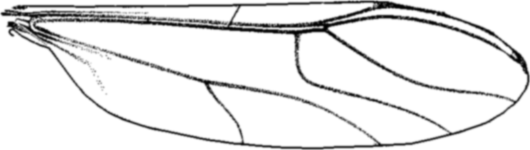

In [1]:
wings[id]

In [1]:
heatmap(wings[id])

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <path clip-path="url(#clip840)" d="M666.849 1834 Q663.237 1834 661.409 1837.57 Q659.603 1841.11 659.603 1848.24 Q659.603 1855.34 661.409 1858.91 Q663.237 1862.45 666.849 1862.45 Q670.483 1862.45 672.288 1858.91 Q674.117 1855.34 674.117 1848.24 Q674.117 1841.11 672.288 1837.57 Q670.483 1834 666.849 1834 M666.849 1830.3 Q672.659 1830.3 675.714 1834.9 Q678.793 1839.49 678.793 1848.24 Q678.793 1856.96 675.714 1861.57 Q672.659 1866.15 666.849 1866.15 Q661.038 1866.15 657.96 1861.57 Q654.904 1856.96 654.904 1848.24 Q654.904 1839.49 657.96 1834.9 Q661.038 1830.3 666.849 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip840)" d="M697.01 1834 Q693.399 1834 691.571 1837.57 Q689.765 1841.11 689.765 1848.24 Q689.765 1855.34 691.571 1858.91 Q693.399 1862.45 697.01 1862.45 Q700.645 1862.45 702.45 1858.91 Q704.279 1855.34 704.279 1848.24 Q704.279 1841.11 702.45 1837.57 Q700.645 1834 697.01 1834 M697.01 1830.3 Q702.821 1830.3 705.876 1834.9 Q708.955 1839.49 708.955 1848.24 Q708.955 1856.96 705.876 1861.57 Q702.821 1866.15 697.01 1866.15 Q691.2 1866.15 688.122 1861.57 Q685.066 1856.96 685.066 1848.24 Q685.066 1839.49 688.122 1834.9 Q691.2 1830.3 697.01 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip840)" d="M1089.86 1861.55 L1106.18 1861.55 L1106.18 1865.48 L1084.23 1865.48 L1084.23 1861.55 Q1086.89 1858.79 1091.48 1854.16 Q1096.08 1849.51 1097.26 1848.17 Q1099.51 1845.65 1100.39 1843.91 Q1101.29 1842.15 1101.29 1840.46 Q1101.29 1837.71 1099.35 1835.97 Q1097.43 1834.23 1094.32 1834.23 Q1092.12 1834.23 1089.67 1835 Q1087.24 1835.76 1084.46 1837.31 L1084.46 1832.59 Q1087.29 1831.46 1089.74 1830.88 Q1092.19 1830.3 1094.23 1830.3 Q1099.6 1830.3 1102.8 1832.98 Q1105.99 1835.67 1105.99 1840.16 Q1105.99 1842.29 1105.18 1844.21 Q1104.39 1846.11 1102.29 1848.7 Q1101.71 1849.37 1098.61 1852.59 Q1095.5 1855.78 1089.86 1861.55 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip840)" d="M1125.99 1834 Q1122.38 1834 1120.55 1837.57 Q1118.74 1841.11 1118.74 1848.24 Q1118.74 1855.34 1120.55 1858.91 Q1122.38 1862.45 1125.99 1862.45 Q1129.62 1862.45 1131.43 1858.91 Q1133.26 1855.34 1133.26 1848.24 Q1133.26 1841.11 1131.43 1837.57 Q1129.62 1834 1125.99 1834 M1125.99 1830.3 Q1131.8 1830.3 1134.86 1834.9 Q1137.93 1839.49 1137.93 1848.24 Q1137.93 1856.96 1134.86 1861.57 Q1131.8 1866.15 1125.99 1866.15 Q1120.18 1866.15 1117.1 1861.57 Q1114.05 1856.96 1114.05 1848.24 Q1114.05 1839.49 1117.1 1834.9 Q1120.18 1830.3 1125.99 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip840)" d="M1156.15 1834 Q1152.54 1834 1150.71 1837.57 Q1148.91 1841.11 1148.91 1848.24 Q1148.91 1855.34 1150.71 1858.91 Q1152.54 1862.45 1156.15 1862.45 Q1159.79 1862.45 1161.59 1858.91 Q1163.42 1855.34 1163.42 1848.24 Q1163.42 1841.11 1161.59 1837.57 Q1159.79 1834 1156.15 1834 M1156.15 1830.3 Q1161.96 1830.3 1165.02 1834.9 Q1168.1 1839.49 1168.1 1848.24 Q1168.1 1856.96 1165.02 1861.57 Q1161.96 1866.15 1156.15 1866.15 Q1150.34 1866.15 1147.26 1861.57 Q1144.21 1856.96 1144.21 1848.24 Q1144.21 1839.49 1147.26 1834.9 Q1150.34 1830.3 1156.15 1830.3 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip840)" d="M1558.2 1846.85 Q1561.55 1847.57 1563.43 1849.84 Q1565.33 1852.1 1565.33 1855.44 Q1565.33 1860.55 1561.81 1863.35 Q1558.29 1866.15 1551.81 1866.15 Q1549.63 1866.15 1547.32 1865.71 Q1545.03 1865.3 1542.57 1864.44 L1542.57 1859.93 Q1544.52 1861.06 1546.83 1861.64 Q1549.15 1862.22 1551.67 1862.22 Q1556.07 1862.22 1558.36 1860.48 Q1560.67 1858.75 1560.67 1855.44 Q1560.67 1852.38 1558.52 1850.67 Q1556.39 1848.93 1552.57 1848.93 L1548.55 1848.93 L1548.55 1845.09 L1552.76 1845.09 Q1556.21 1845.09 1558.04 1843.72 Q1559.86 1842.34 1559.86 1839.74 Q1559.86 1837.08 1557.97 1835.67 Q1556.09 1834.23 1552.57 1834.23 Q1550.65 1834.

The reason is that it has one small cycle right at the beggining of the filtration…

## 3 Draft…..

In [1]:
ps = map(reverse([0:0.1:0.9;])) do tr
  X = findall_ids(>(tr), Af)
  title = "threshold: $tr"
  p = scatter(first.(X), last.(X), title = title)
  # display(p)
end

plot(ps...)

<?xml version="1.0" encoding="utf-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <path clip-path="url(#clip900)" d="M252.082 554.002 Q248.471 554.002 246.642 557.567 Q244.836 561.108 244.836 568.238 Q244.836 575.344 246.642 578.909 Q248.471 582.451 252.082 582.451 Q255.716 582.451 257.521 578.909 Q259.35 575.344 259.35 568.238 Q259.35 561.108 257.521 557.567 Q255.716 554.002 252.082 554.002 M252.082 550.298 Q257.892 550.298 260.947 554.905 Q264.026 559.488 264.026 568.238 Q264.026 576.965 260.947 581.571 Q257.892 586.155 252.082 586.155 Q246.272 586.155 243.193 581.571 Q240.137 576.965 240.137 568.238 Q240.137 559.488 243.193 554.905 Q246.272 550.298 252.082 550.298 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip900)" d="M303.616 566.34 Q300.468 566.34 298.616 568.493 Q296.787 570.645 296.787 574.395 Q296.787 578.122 298.616 580.298 Q300.468 582.451 303.616 582.451 Q306.764 582.451 308.593 580.298 Q310.444 578.122 310.444 574.395 Q310.444 570.645 308.593 568.493 Q306.764 566.34 303.616 566.34 M312.898 551.687 L312.898 555.946 Q311.139 555.113 309.333 554.673 Q307.551 554.233 305.792 554.233 Q301.162 554.233 298.708 557.358 Q296.278 560.483 295.931 566.803 Q297.296 564.789 299.356 563.724 Q301.417 562.636 303.893 562.636 Q309.102 562.636 312.111 565.807 Q315.143 568.956 315.143 574.395 Q315.143 579.719 311.995 582.937 Q308.847 586.155 303.616 586.155 Q297.62 586.155 294.449 581.571 Q291.278 576.965 291.278 568.238 Q291.278 560.044 295.167 555.183 Q299.056 550.298 305.606 550.298 Q307.366 550.298 309.148 550.646 Q310.954 550.993 312.898 551.687 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip900)" d="M333.199 554.002 Q329.588 554.002 327.759 557.567 Q325.954 561.108 325.954 568.238 Q325.954 575.344 327.759 578.909 Q329.588 582.451 333.199 582.451 Q336.833 582.451 338.639 578.909 Q340.467 575.344 340.467 568.238 Q340.467 561.108 338.639 557.567 Q336.833 554.002 333.199 554.002 M333.199 550.298 Q339.009 550.298 342.065 554.905 Q345.143 559.488 345.143 568.238 Q345.143 576.965 342.065 581.571 Q339.009 586.155 333.199 586.155 Q327.389 586.155 324.31 581.571 Q321.254 576.965 321.254 568.238 Q321.254 559.488 324.31 554.905 Q327.389 550.298 333.199 550.298 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip900)" d="M384.698 569.071 Q381.365 569.071 379.444 570.854 Q377.545 572.636 377.545 575.761 Q377.545 578.886 379.444 580.669 Q381.365 582.451 384.698 582.451 Q388.031 582.451 389.953 580.669 Q391.874 578.863 391.874 575.761 Q391.874 572.636 389.953 570.854 Q388.055 569.071 384.698 569.071 M380.022 567.081 Q377.013 566.34 375.323 564.28 Q373.657 562.22 373.657 559.257 Q373.657 555.113 376.596 552.706 Q379.559 550.298 384.698 550.298 Q389.86 550.298 392.8 552.706 Q395.74 555.113 395.74 559.257 Q395.74 562.22 394.05 564.28 Q392.383 566.34 389.397 567.081 Q392.777 567.868 394.652 570.159 Q396.55 572.451 396.55 575.761 Q396.55 580.784 393.471 583.469 Q390.416 586.155 384.698 586.155 Q378.981 586.155 375.902 583.469 Q372.846 580.784 372.846 575.761 Q372.846 572.451 374.744 570.159 Q376.643 567.868 380.022 567.081 M378.309 559.696 Q378.309 562.382 379.976 563.886 Q381.666 565.391 384.698 565.391 Q387.707 565.391 389.397 563.886 Q391.11 562.382 391.11 559.696 Q391.11 557.011 389.397 555.507 Q387.707 554.002 384.698 554.002 Q381.666 554.002 379.976 555.507 Q378.309 557.011 378.309 559.696 Z" fill="#000000" fill-rule="nonzero" fill-opacity="1" /><path clip-path="url(#clip900)" d="M414.86 554.002 Q411.249 554.002 409.42 557.567 Q407.615 561.108 407.615 568.238 Q407.615 575.344 409.42 578.909 Q411.249 582.451 414.86 582.451 Q418.494 582.451 420.3 578.909 Q422.128 575.344 422.128 568.238 Q422.128 561.108 420.3 557.567 Q418.494 554.002 414.86 554.002 M414.86 550.298 Q420.67 550.298 423.726 554.905 Q426.804 559.488 426.804 568.238 Q426.804 576.965 423.726 581.571 Q420.67 586.155 414.86 586.155 Q409.05 586.155 405.971